# PREOPS-875: Inspecting forced photometry light curves

This work was done in Nov 2021 - Jan 2022. A summary writeup will appear in RTN-027.

In [2]:
%matplotlib notebook
import os
import sys
import numpy as np
import matplotlib.pyplot as plt
#import importlib
import pandas as pd

from astropy.coordinates import SkyCoord
import astropy.units as u
from statsmodels.stats.weightstats import DescrStatsW
from scipy.stats import median_abs_deviation

import lsst.geom
import lsst.daf.butler as dafButler
import lsst.afw.display as afwDisplay

In [3]:
butler = dafButler.Butler(config="s3://butler-us-central1-panda-dev/dc2/butler-external.yaml")

In [4]:
# collection1 is the shallower tracts 3828 and 3829
# collection2 is the deeper tract 4431

collection1 = '2.2i/runs/test-med-1/v23_0_0_rc2/PREOPS-863'
collection2 = '2.2i/runs/test-tract4431/v23_0_0_rc2/PREOPS-728'

In [5]:
skymap = 'DC2'
instrument = 'LSSTCam-imSim'
instrumentDataId = butler.registry.expandDataId(instrument=instrument)
packer = butler.registry.dimensions.makePacker("visit_detector", instrumentDataId)

### Make sure calexps exist where we think they should, zeroth order reality check

In [5]:
butler.registry.queryDatasets('calexp', collections=collection1, tract=3828, skymap=skymap).count()

15242

In [6]:
butler.registry.queryDatasets('calexp', collections=collection1, tract=3829, skymap=skymap).count()

11708

In [7]:
butler.registry.queryDatasets('calexp', collections=collection2, tract=4431, skymap=skymap).count()

63916

## Find some "forced source catalogs"
Also remember how to do queries from within python...

Datasets called `forced_src` exist, but those are afwTable flavored. We should instead introspect the parquet-flavored `forcedSourceTable` datasets.

We expect one `forcedSourceTable` dataset to exist per patch. Each tract has 49 patches (0 through 48).


In [8]:
butler.registry.queryDatasets('forcedSourceTable', collections=collection1, skymap=skymap).count()

98

In [9]:
butler.registry.queryDatasets('forcedSourceTable', collections=collection2, skymap=skymap).count()

49

In [10]:
# Can do queries like this to get a valid visit list
query = butler.registry.queryDataIds(dimensions=['visit'], collections=collection1,
                                     datasets='forcedSourceTable', skymap=skymap, instrument=instrument,
                                     tract=3828, patch=47)
visitList = list(set([dataId['visit'] for dataId in list(query)]))
visitList.sort()
print(visitList, len(visitList))

[2337, 5884, 5886, 7998, 8003, 12466, 12483, 13288, 13331, 32680, 37657, 159471, 159491, 162699, 167863, 169839, 174534, 174535, 179999, 180000, 180001, 183772, 183818, 187533, 189317, 189318, 189382, 189389, 190282, 190503, 192355, 193189, 193233, 193849, 193888, 202590, 202617, 202627, 204706, 206033, 206039, 206073, 207784, 207791, 209018, 209031, 209068, 209082, 209843, 211099, 211141, 211477, 211490, 211527, 211530, 211545, 212070, 212071, 212085, 212119, 213513, 213545, 214434, 214465, 218326, 219950, 221574, 221614, 226983, 227029, 227030, 227951, 227976, 227984, 235058, 240846, 243019, 243024, 244005, 244028, 244029, 244068, 252377, 252422, 252424, 254358, 254379, 254381, 254407, 256383, 263453, 263455, 263502, 265317, 266117, 266118, 271328, 277060, 277061, 277093, 280217, 282445, 303559, 306181, 306182, 390559, 390569, 397279, 397322, 397323, 397330, 397331, 398407, 398413, 400438, 400440, 401615, 401660, 406992, 406996, 407888, 407919, 407950, 407951, 408941, 410886, 410996,

## Load a forcedSourceTable, and pull in exposure midpoints from a ccdVisitId table

In [61]:
# Only load columns you actually need because there are LOTS OF ROWS

test_forcedSrc = butler.get('forcedSourceTable', collections=collection1,
                            tract=3828, patch=47,
                            skymap=skymap, instrument=instrument,
                            parameters={"columns": ["objectId", "parentObjectId", "coord_ra", "coord_dec",
                                                    "ccdVisitId", "band", "psfFlux", "psfFluxErr", "psfDiffFlux",
                                                    "psfDiffFluxErr", "tract", "patch", "detect_isPrimary",
                                                    "detect_isTractInner", "detect_isPatchInner", ]})

In [62]:
test_ccdVisitTable = butler.get('ccdVisitTable', collections=collection1,
                                tract=3828, patch=47,
                                skymap=skymap, instrument=instrument)

In [17]:
test_objectTable = butler.get('objectTable', collections=collection1,
                              tract=3828, patch=47, skymap=skymap, instrument=instrument)

In [18]:
test_objectTable
# TODO: only use objects with detect_isPrimary True and brighter than some flux threshold... (flux/fluxerr decent)

column,shape_yy,detect_isDeblendedSource,footprintArea,parentObjectId,deblend_nChild,deblend_skipped,coord_ra,refExtendedness,shape_flag,detect_fromBlend,...,g_kronFlux_flag,g_kronFlux_flag_bad_radius,g_kronFlux_flag_bad_shape,g_kronFlux_flag_bad_shape_no_psf,g_kronFlux_flag_edge,g_kronFlux_flag_no_fallback_radius,g_kronFlux_flag_no_minimum_radius,g_kronFlux_flag_small_radius,g_kronFlux_flag_used_minimum_radius,g_kronFlux_flag_used_psf_radius
objectId,,,,,,,,,,,,,,,,,,,,,
1650314176733642753,3.606204,False,1201,0,5,False,56.224646,NaN,True,False,...,True,False,True,False,True,False,False,False,False,False
1650314176733642754,4.323729,True,140,0,1,False,56.218749,NaN,True,False,...,True,False,True,False,True,False,False,False,False,False
1650314176733642755,NaN,True,195,0,1,False,56.199754,NaN,True,False,...,True,False,True,False,True,False,False,False,False,False
1650314176733642756,5.219087,True,154,0,1,False,56.187548,NaN,True,False,...,True,False,True,False,True,False,False,False,False,False
1650314176733642757,4.891757,True,178,0,1,False,56.183777,NaN,True,False,...,True,False,True,False,True,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1650314176733682925,4.532123,False,121,1650314176733654575,0,False,56.082085,1.0,False,False,...,True,False,True,False,False,False,False,False,False,False
1650314176733682926,4.125756,False,121,1650314176733654576,0,False,56.204794,1.0,False,False,...,False,False,False,False,False,False,False,False,False,False
1650314176733682927,5.132142,False,121,1650314176733654577,0,False,56.094177,1.0,False,False,...,False,False,False,False,False,False,False,False,False,False


In [65]:
test_ccdVisitTable

,visitId,physical_filter,band,ra,decl,zenithDistance,zeroPoint,psfSigma,skyBg,skyNoise,...,xSize,ySize,llcra,llcdec,ulcra,ulcdec,urcra,urcdec,lrcra,lrcdec
ccdVisitId,,,,,,,,,,,,,,,,,,,,,
2334027,2334,u_sim_1.4,u,59.365904,-35.942340,15.237252,30.472204,1.973239,46.472614,10.770882,...,4071,3999,59.179513,-35.895416,59.426820,-35.791736,59.552652,-35.988999,59.304800,-36.092893
2334028,2334,u_sim_1.4,u,59.622536,-35.834224,15.006802,30.480417,1.967542,46.444649,10.770079,...,4071,3999,59.436092,-35.787713,59.682950,-35.683439,59.809318,-35.880474,59.561937,-35.984967
2334030,2334,u_sim_1.4,u,59.498990,-36.150544,15.197104,30.477169,1.965033,46.500870,10.774090,...,4071,3999,59.311920,-36.103771,59.559799,-35.999852,59.686380,-36.197030,59.438002,-36.301165
2334033,2334,u_sim_1.4,u,59.632538,-36.358826,15.160652,30.475172,1.972056,46.424702,10.777279,...,4071,3999,59.444816,-36.312177,59.693275,-36.208090,59.820613,-36.405209,59.571606,-36.509498
2336000,2336,u_sim_1.4,u,57.449447,-35.689914,16.933561,30.473707,2.011923,46.661568,10.787661,...,4071,3999,57.264192,-35.641562,57.512382,-35.539932,57.635052,-35.737997,57.386287,-35.839892
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
496989184,496989,i_sim_1.4,i,58.001046,-36.075909,44.096149,31.845556,1.792896,3718.577393,72.746887,...,4071,3999,57.807700,-36.101017,57.973433,-35.919076,58.194168,-36.050500,58.028744,-36.232713
496989185,496989,i_sim_1.4,i,58.172089,-35.886951,43.986263,31.845991,1.803988,3718.831055,72.826355,...,4071,3999,57.979355,-35.912324,58.144152,-35.730175,58.364583,-35.861280,58.200105,-36.043707
496989186,496989,i_sim_1.4,i,58.062081,-36.403608,44.001747,31.847563,1.795575,3718.587646,72.831764,...,4071,3999,57.867992,-36.428906,58.034253,-36.246851,58.255937,-36.377998,58.089988,-36.560314


In [64]:
test_forcedSrc['forcedSourceId'] = test_forcedSrc.index
test_forcedSrc = pd.merge(test_forcedSrc, test_ccdVisitTable['expMidpt'], on='ccdVisitId', how='left').set_index('forcedSourceId')

In [14]:
test_forcedSrc_good = test_forcedSrc.loc[(test_forcedSrc['detect_isTractInner'] == True) & \
                                (test_forcedSrc['detect_isPatchInner'] == True)]

In [15]:
objectList = list(set(test_forcedSrc_good.objectId))
print(len(objectList))

22126


In [16]:
test_forcedSrc_good.columns  # it has expMidpt now!

Index(['objectId', 'parentObjectId', 'coord_ra', 'coord_dec', 'ccdVisitId',
       'band', 'psfFlux', 'psfFluxErr', 'psfDiffFlux', 'psfDiffFluxErr',
       'tract', 'patch', 'detect_isPrimary', 'detect_isTractInner',
       'detect_isPatchInner', 'expMidpt'],
      dtype='object')

In [17]:
test_forcedSrc_good.iloc[0]

objectId                      1650314176733642965
parentObjectId                                  0
coord_ra                                 55.97006
coord_dec                              -35.888082
ccdVisitId                              496989093
band                                            i
psfFlux                               7415.002105
psfFluxErr                             354.364529
psfDiffFlux                            100.185835
psfDiffFluxErr                         359.029817
tract                                        3828
patch                                          47
detect_isPrimary                            False
detect_isTractInner                          True
detect_isPatchInner                          True
expMidpt               2023-12-31 05:29:44.668900
Name: 266818987612974017, dtype: object

## Plot some light curves!

In [6]:
def color_assigner(band):
    colorDict = {'u': 'C0', 'g': 'C2', 'r': 'C1', 'i': 'C3', 'z': 'C4', 'y': 'k'}
    return colorDict[band]

def ax_assigner(band):
    axDict = {'u': [0,0], 'g': [0,1], 'r': [1,0], 'i': [1,1], 'z': [2,0], 'y': [2,1]}
    return axDict[band]

<IPython.core.display.Javascript object>


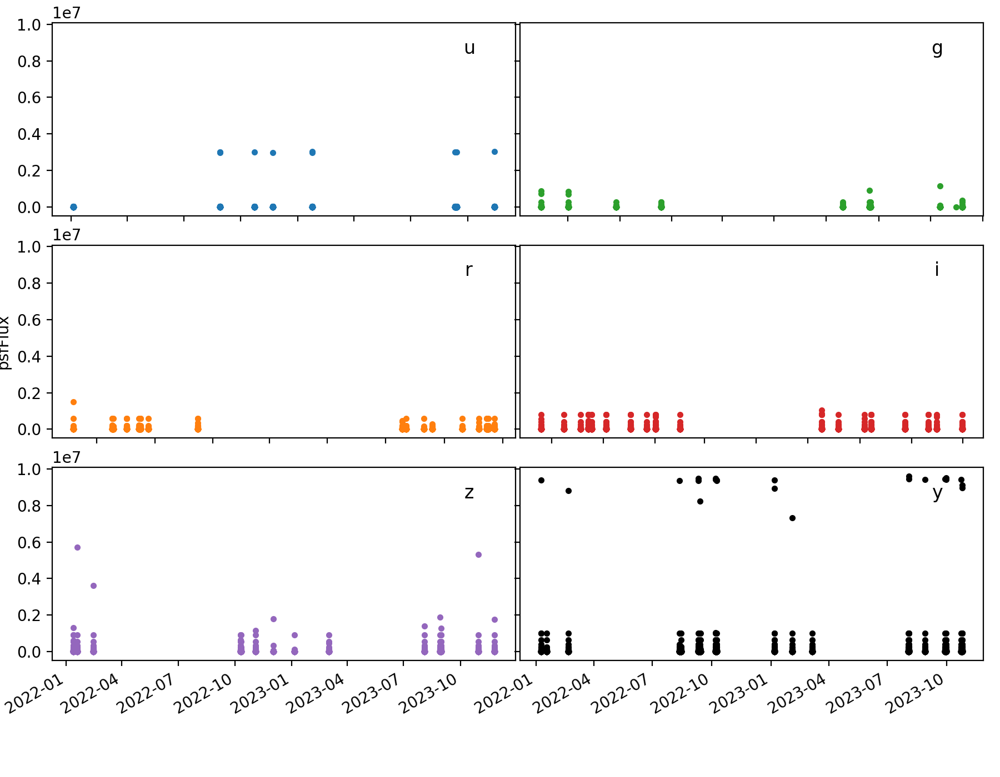

In [19]:
fig, axs = plt.subplots(3, 2, figsize=(9,7), sharey=True)
fig.autofmt_xdate()
fig.tight_layout()

for obj in objectList[0:1000]:  # CAREFUL, this is a lot of objects without indexing
    rows = test_forcedSrc_good.loc[test_forcedSrc_good.objectId == obj]
    for band in ['u', 'g', 'r', 'i', 'z', 'y']:
        axIdx = tuple(ax_assigner(band))
        color = color_assigner(band)
        data = rows.loc[rows['band'] == band]
        axs[axIdx].errorbar(data.expMidpt, data.psfFlux, yerr=data.psfFluxErr, marker='.', ls='None',
                            color=color, label=obj)
        axs[axIdx].set_title(band, x=0.9, y=1.0, pad=-20)
        axs[axIdx].ticklabel_format(axis='y', style='sci', scilimits=(0,0))
        if band == 'r':
            axs[axIdx].set_ylabel('psfFlux')

plt.subplots_adjust(bottom=0.15, wspace=0.01)
#plt.legend()

### Investigate how variable the objects are

In [7]:
def analyzeObjectLc(obj, df, doPlot=False, printStats=False):
    """obj should be an objectId
    df should be a forcedSourceTable with columns `expMidpt`, `psfFlux`, `psfFluxErr`, and `band`.
    """
    rows = df.loc[df.objectId == obj]
    rows = rows.sort_values(by=['expMidpt'])
    #colors = list(map(color_assigner, rows.band))
    if doPlot:
        fig, ax = plt.subplots(1,1, figsize=(9,4))
        fig.autofmt_xdate()
        ax.set_title('objectId ' + str(rows.index[0]))
    if printStats:
        print('band nobs CV MAD')
        print('----------------')
    cvList = []
    madList = []
    for band in ['u', 'g', 'r', 'i', 'z', 'y']:
        npoints = len(rows.loc[rows['band'] == band])
        times = rows.loc[rows['band'] == band, 'expMidpt']
        fluxes = rows.loc[rows['band'] == band, 'psfFlux']
        fluxerrs = rows.loc[rows['band'] == band, 'psfFluxErr']
        # compute weighted coefficient of variation
        dsw = DescrStatsW(fluxes, 1./fluxerrs)  # descriptive statistics and tests with weights for case weights
        cv = dsw.std / np.abs(dsw.mean)  # weighted std / absolute value of weighted mean
        cvList.append(cv)
        # compute median absolute deviation
        mad = median_abs_deviation(fluxes)  # THIS DOES NOT USE THE FLUXERRS!!!
        madList.append(mad)
        if printStats:
            print(f'{band} {npoints} {cv:4.3f} {mad:5.2f}')
        if doPlot:
            color = color_assigner(band)
            ax.errorbar(times, fluxes, yerr=fluxerrs, marker='o', color=color, ms=4, ls=':', label=band)
    if doPlot:
        plt.legend()
    return cvList, madList

<IPython.core.display.Javascript object>


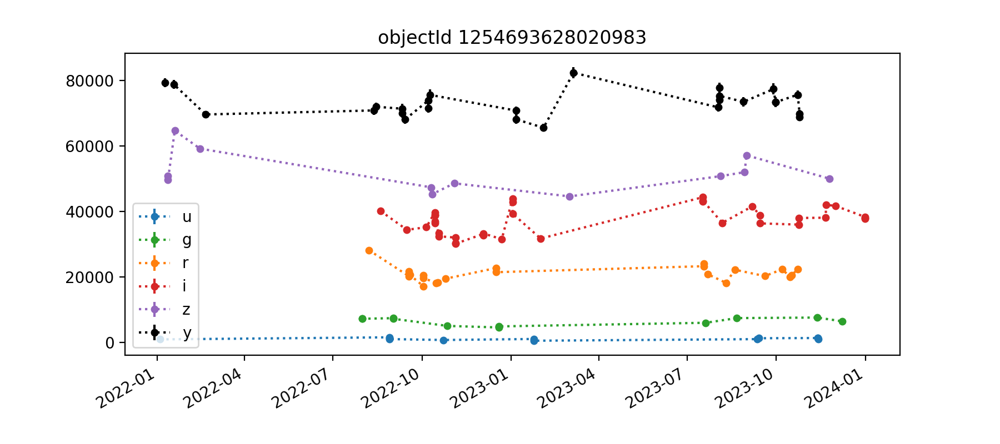

band nobs CV MAD
----------------
u 12 0.253 268.84
g 12 0.191 676.38
r 22 0.106 1368.76
i 36 0.110 3580.34
z 12 0.103 2404.71
y 26 0.053 2757.51


<IPython.core.display.Javascript object>


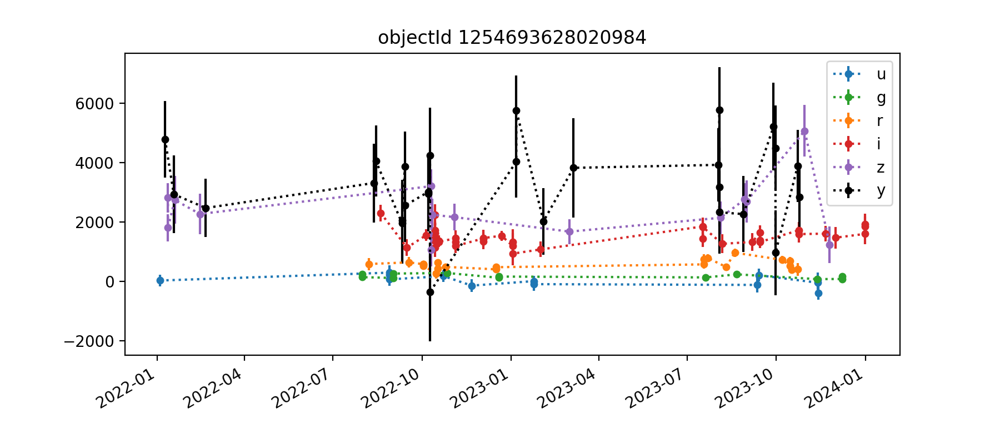

band nobs CV MAD
----------------
u 13 8.681 148.27
g 12 0.401 54.42
r 21 0.263 94.92
i 38 0.184 154.81
z 14 0.364 493.91
y 27 0.401 855.42


<IPython.core.display.Javascript object>


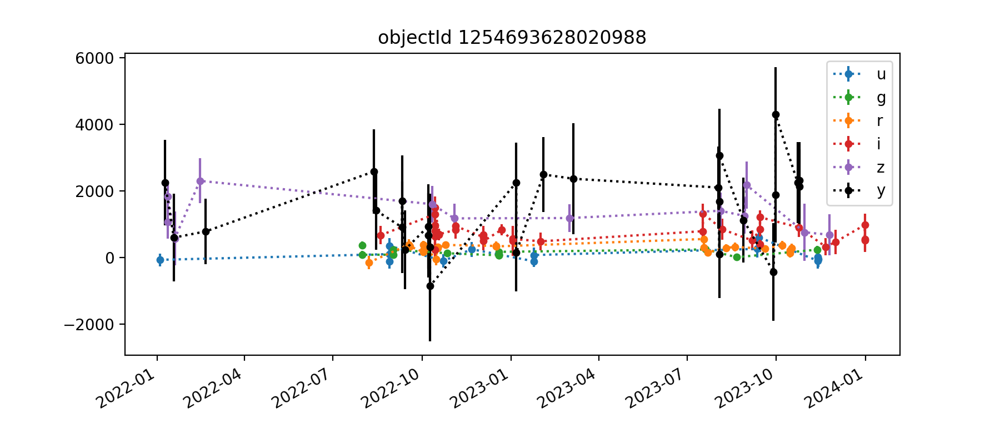

band nobs CV MAD
----------------
u 13 2.859 115.08
g 11 0.642 59.90
r 22 0.473 73.92
i 31 0.383 177.09
z 12 0.366 422.29
y 27 0.754 773.70


<IPython.core.display.Javascript object>


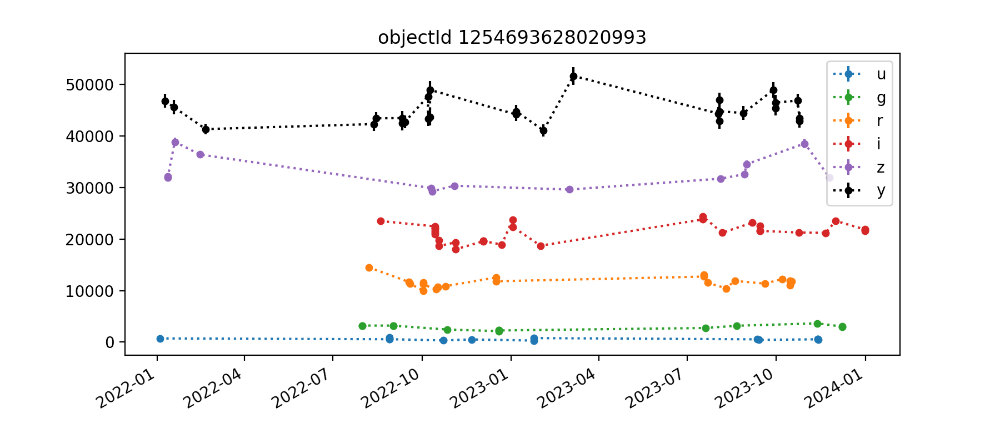

band nobs CV MAD
----------------
u 13 0.309 108.42
g 13 0.168 192.71
r 22 0.082 583.57
i 31 0.081 1072.97
z 13 0.088 2008.02
y 27 0.054 1466.94


<IPython.core.display.Javascript object>


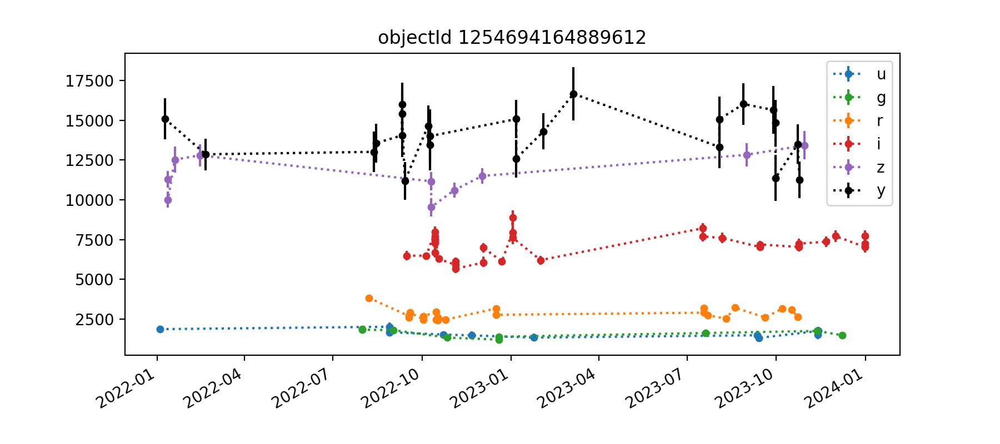

band nobs CV MAD
----------------
u 11 0.131 190.36
g 9 0.151 206.99
r 22 0.113 220.34
i 32 0.104 470.14
z 10 0.104 1263.25
y 23 0.108 1032.65


<IPython.core.display.Javascript object>


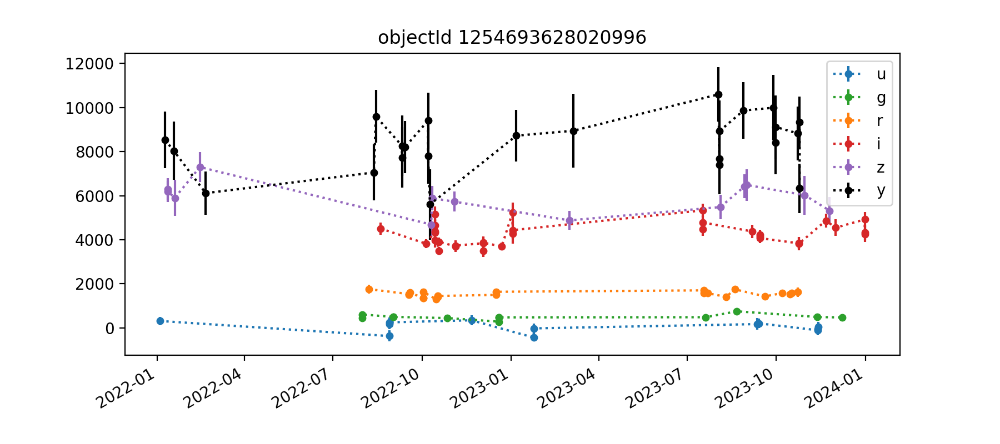

band nobs CV MAD
----------------
u 12 7.701 159.62
g 12 0.218 18.30
r 22 0.080 82.70
i 32 0.115 401.49
z 13 0.115 417.30
y 24 0.148 765.61


<IPython.core.display.Javascript object>


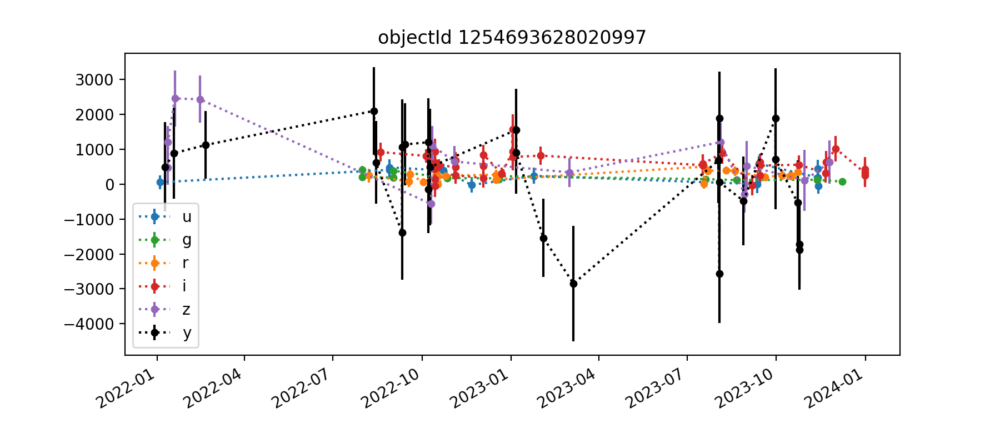

band nobs CV MAD
----------------
u 12 0.833 196.42
g 12 0.453 38.91
r 21 0.539 55.24
i 36 0.531 235.03
z 13 1.092 522.61
y 25 8.111 766.08


<IPython.core.display.Javascript object>


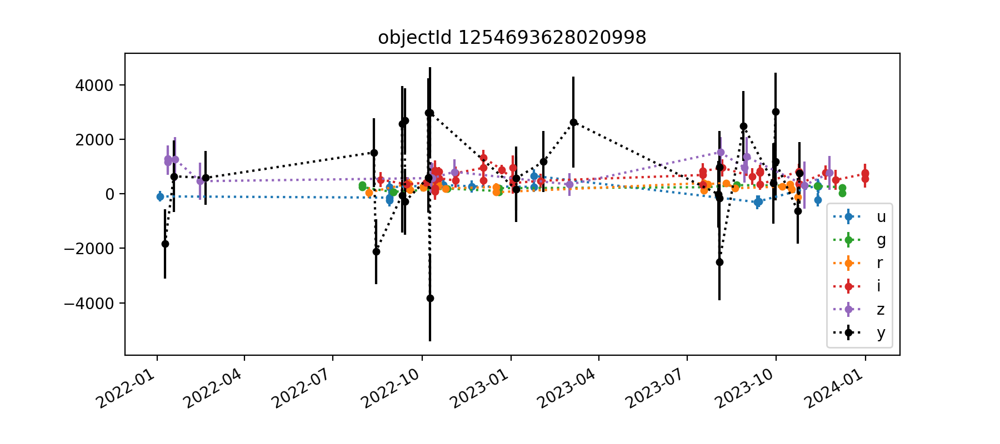

band nobs CV MAD
----------------
u 13 3.395 337.26
g 13 0.557 105.15
r 22 0.464 90.35
i 37 0.401 186.99
z 14 0.448 347.05
y 27 2.792 879.52


<IPython.core.display.Javascript object>


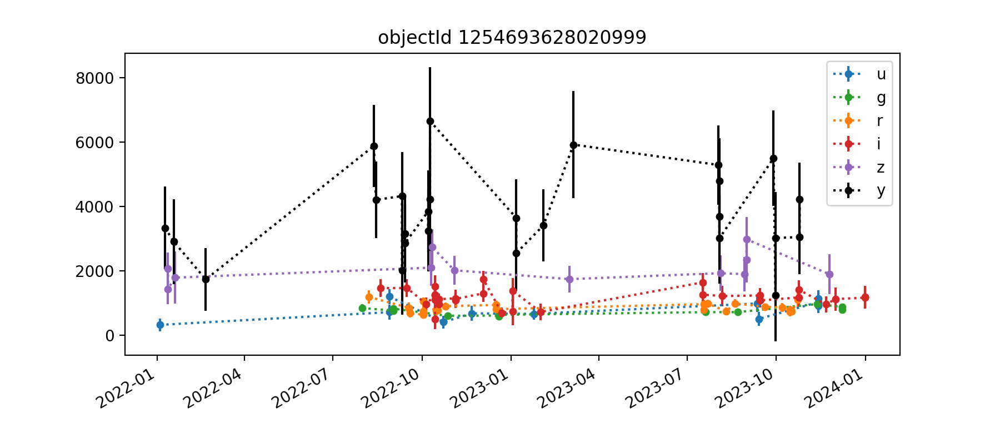

band nobs CV MAD
----------------
u 11 0.376 269.15
g 12 0.159 106.36
r 23 0.156 79.36
i 31 0.229 100.62
z 12 0.196 155.53
y 26 0.342 686.14


<IPython.core.display.Javascript object>


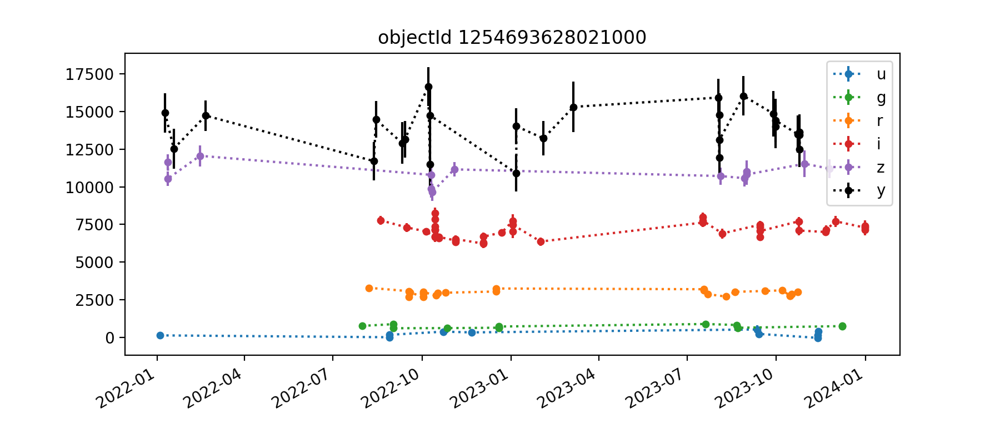

band nobs CV MAD
----------------
u 10 0.673 155.55
g 12 0.128 94.79
r 23 0.058 126.18
i 39 0.071 445.13
z 13 0.059 340.48
y 27 0.101 1095.27


<IPython.core.display.Javascript object>


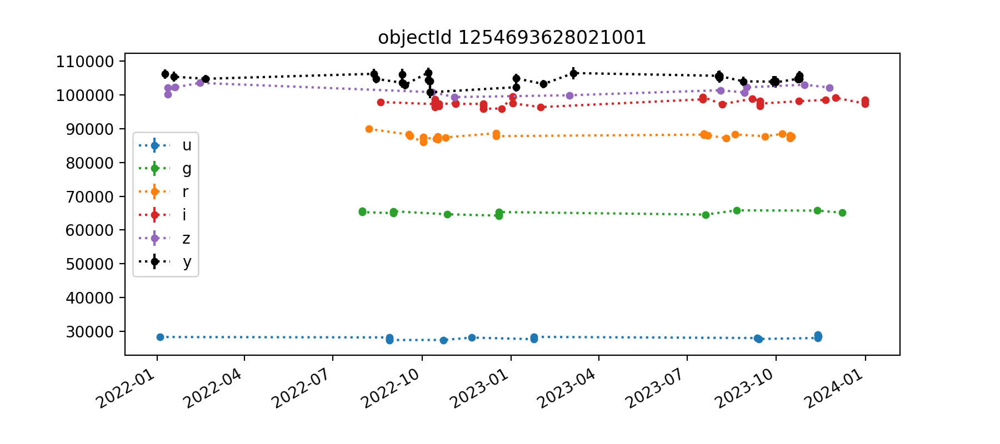

band nobs CV MAD
----------------
u 13 0.015 324.66
g 12 0.008 503.90
r 22 0.009 517.27
i 31 0.010 745.73
z 12 0.012 967.37
y 27 0.012 894.99


<IPython.core.display.Javascript object>


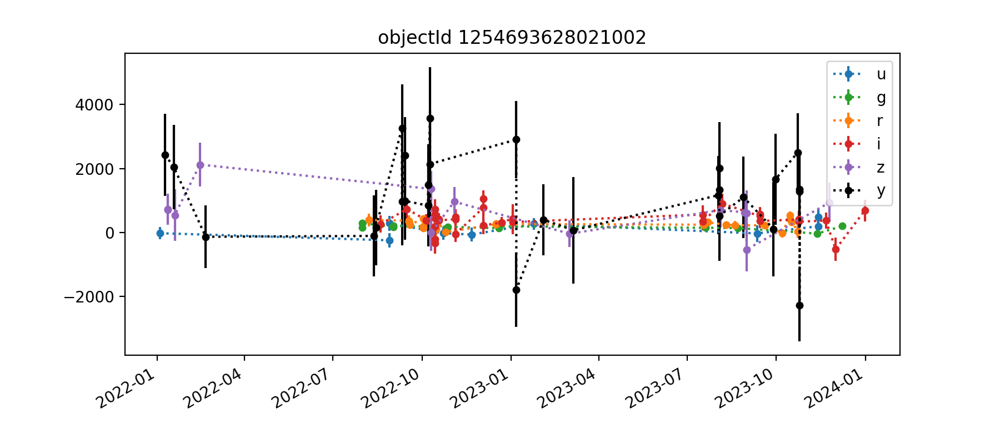

band nobs CV MAD
----------------
u 9 2.221 215.94
g 12 0.364 23.37
r 22 0.526 90.74
i 31 0.748 140.65
z 13 0.914 241.02
y 28 1.219 871.46


<IPython.core.display.Javascript object>


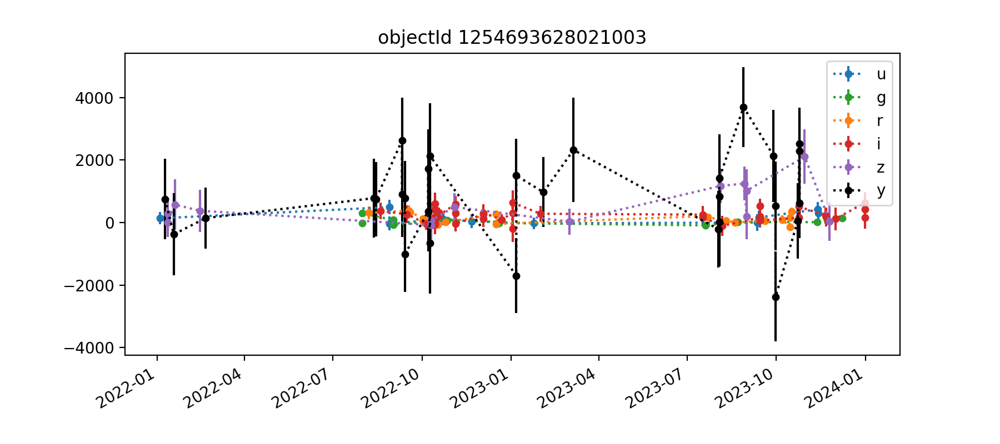

band nobs CV MAD
----------------
u 10 1.125 136.72
g 12 2.964 48.23
r 22 1.185 102.55
i 37 0.852 106.31
z 14 1.182 293.60
y 29 1.640 754.33


<IPython.core.display.Javascript object>


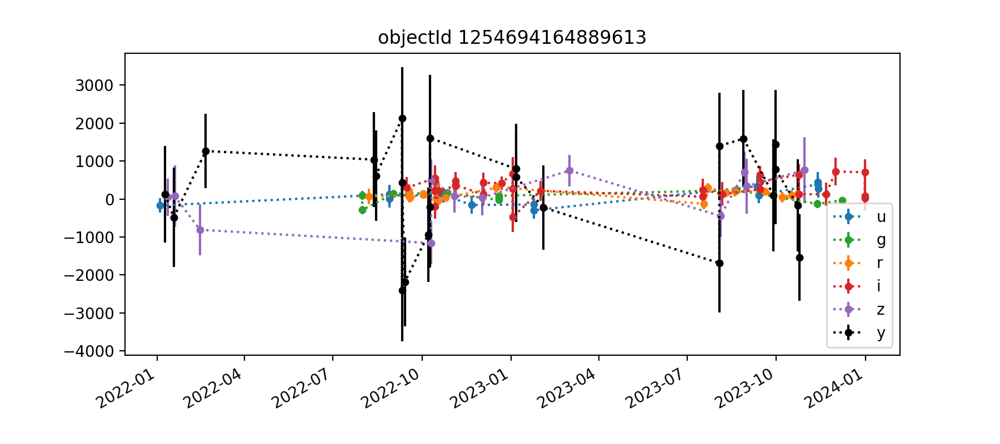

band nobs CV MAD
----------------
u 13 3.221 235.43
g 10 3.523 92.79
r 22 1.020 81.48
i 30 0.810 159.60
z 12 7.371 466.82
y 23 8.179 826.32


<IPython.core.display.Javascript object>


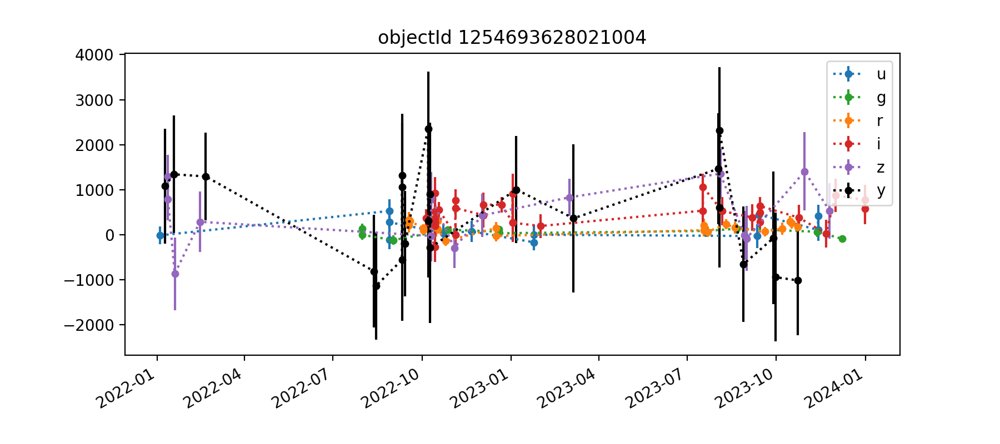

band nobs CV MAD
----------------
u 12 1.858 123.96
g 11 1.368 57.23
r 22 0.744 68.94
i 31 0.580 199.08
z 14 1.260 496.19
y 22 2.312 823.73


<IPython.core.display.Javascript object>


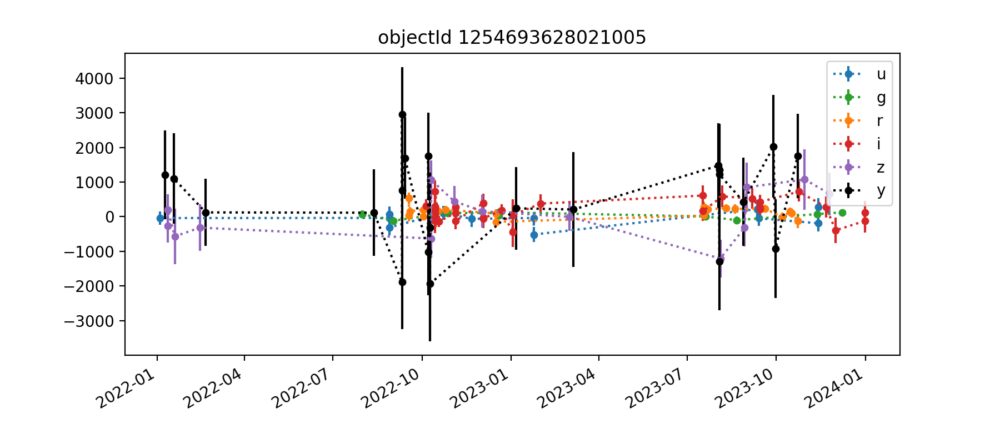

band nobs CV MAD
----------------
u 12 4.059 131.03
g 11 1.278 37.45
r 22 1.016 71.48
i 32 1.410 187.15
z 14 10.817 488.15
y 22 2.331 893.29


<IPython.core.display.Javascript object>


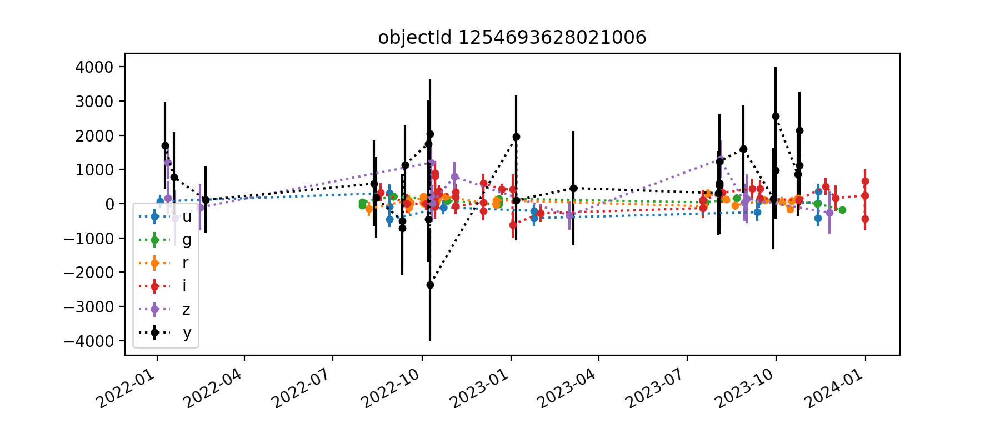

band nobs CV MAD
----------------
u 12 2.627 172.41
g 12 1.860 83.56
r 22 2.067 85.86
i 35 1.537 177.74
z 13 1.794 412.79
y 26 1.343 561.38


<IPython.core.display.Javascript object>


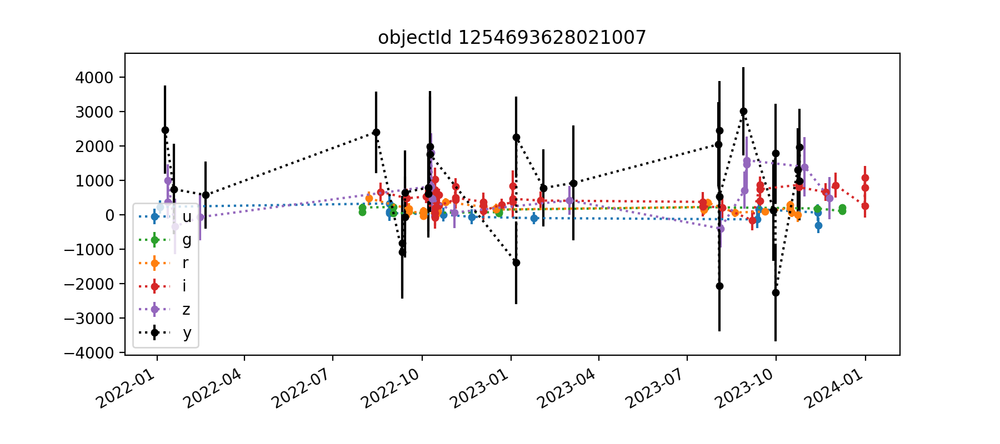

band nobs CV MAD
----------------
u 11 6.204 110.21
g 11 0.517 65.16
r 21 0.806 66.08
i 37 0.577 208.13
z 15 1.023 521.22
y 27 1.638 998.78


<IPython.core.display.Javascript object>


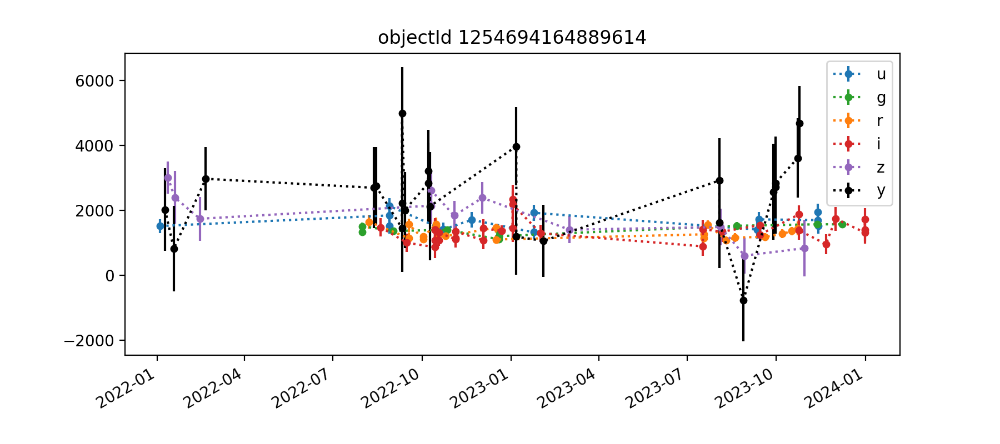

band nobs CV MAD
----------------
u 13 0.143 183.70
g 10 0.113 133.10
r 21 0.137 107.68
i 32 0.218 144.99
z 11 0.372 548.05
y 23 0.507 671.43


/tmp/ipykernel_2622/2062798326.py:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(1,1, figsize=(9,4))


<IPython.core.display.Javascript object>


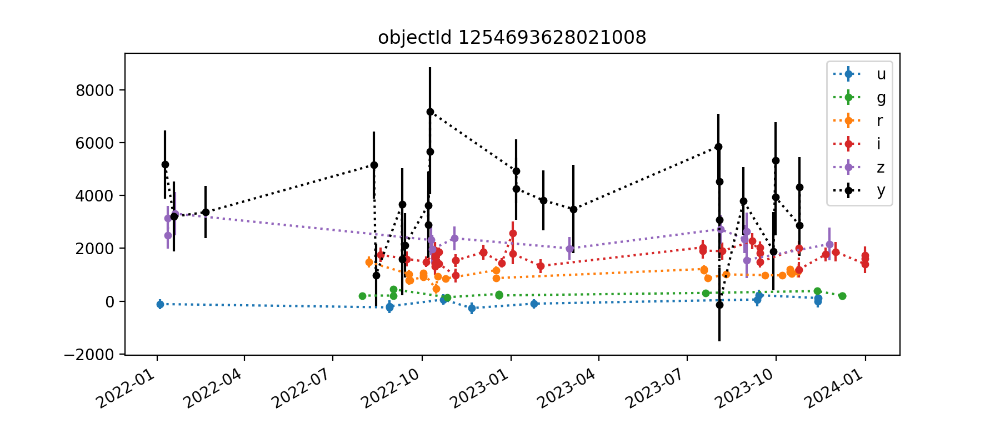

band nobs CV MAD
----------------
u 11 5.409 121.18
g 11 0.309 10.36
r 22 0.173 121.83
i 34 0.175 191.15
z 12 0.186 314.49
y 26 0.415 848.84


In [47]:
for obj in objectList[0:20]:
    result = analyzeObjectLc(obj, test_forcedSrc_good, doPlot=True, printStats=True)

### First attempt at aggregated statistics

Eventually, we ought to put the variability statistics in a more plot-friendly format and plot it for all objects. We also need to scale this up for more than one patch, and more than one tract.

In [22]:
statsMultiObjectList = []
for obj in objectList[0:10]:
    statsMultiObjectList.append(analyzeObjectLc(obj, test_forcedSrc_good))

In [23]:
statsMultiObjectList  # for each object, there's a weighted CV per band and a MAD per band...

[([0.25315832265432586,
   0.19139298666160745,
   0.10620346561660088,
   0.10967007794696479,
   0.10295240345827468,
   0.05270590177870392],
  [268.839500013914,
   676.3789225549335,
   1368.7557422554928,
   3580.336641988044,
   2404.7058731687175,
   2757.507468651638]),
 ([8.680640692774697,
   0.40125992391632925,
   0.26253566285675173,
   0.1838538353036029,
   0.36417494552545315,
   0.40118533449928445],
  [148.2743669612208,
   54.41888559983689,
   94.9249523873089,
   154.80829063043984,
   493.9123025506399,
   855.4217642730814]),
 ([2.858685568917284,
   0.6415268523192175,
   0.47326701283775174,
   0.3825530779572395,
   0.3660696232814255,
   0.7539054542668132],
  [115.08456622455189,
   59.89599121195084,
   73.921709379266,
   177.09438954085476,
   422.29330368401327,
   773.6959062152705]),
 ([0.3089384546760888,
   0.16768540767577417,
   0.08193576704944708,
   0.08070916245434441,
   0.08839544819590427,
   0.0536464967537836],
  [108.4244734543156,
   19

## Plot psfFlux histograms

In [7]:
def plot_flux_histogram_by_band(df, fluxcol, num_bins=50, title=None, histrange=(-1.5e3, 4e3), sharey=True):
    """df should be a forcedSourceTable with columns `fluxcol` and `band`."""
    fig, axs = plt.subplots(3, 2, figsize=(5,8), sharey=sharey)
    if title:
        plt.suptitle(title)
    if sharey:
        plt.subplots_adjust(hspace=0.1, wspace=0)
    if not sharey:
        plt.subplots_adjust(hspace=0.1, wspace=0.2)

    for band in ['u', 'g', 'r', 'i', 'z', 'y']:
        axIdx = tuple(ax_assigner(band))
        axs[axIdx].ticklabel_format(axis='y', style='sci', scilimits=(0,0))
        color = color_assigner(band)
        if band not in ['z', 'y']:
            axs[axIdx].axes.get_xaxis().set_visible(False)
        axs[axIdx].set_title(band, x=0.9, y=1.0, pad=-20)
        oneBandDf = df.loc[df.band==band]
        n, bins, patches = axs[axIdx].hist(oneBandDf[fluxcol], num_bins, range=histrange, color=color)

<IPython.core.display.Javascript object>


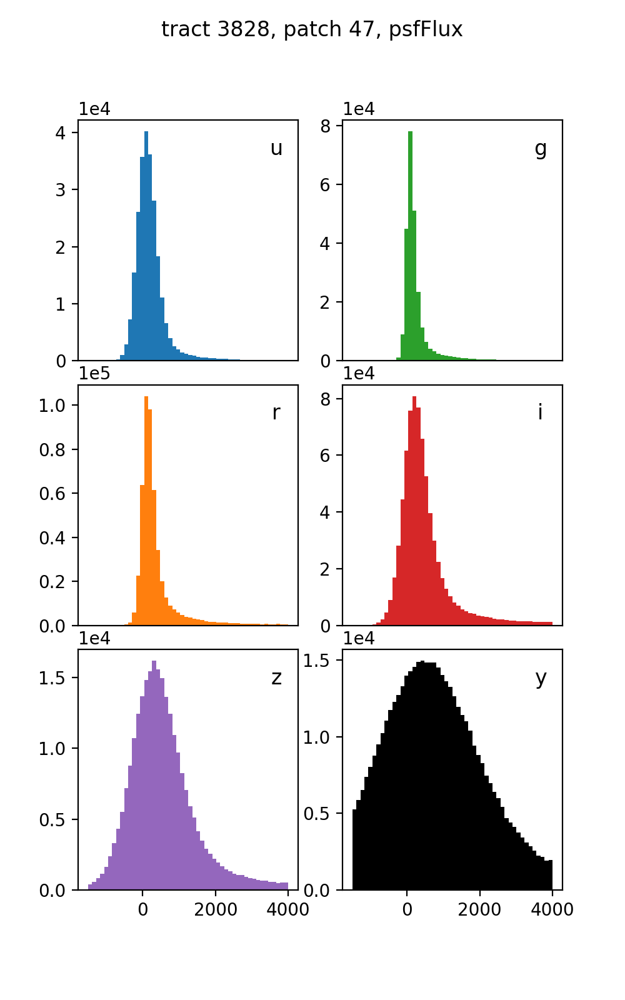

In [26]:
plot_flux_histogram_by_band(test_forcedSrc_good, 'psfFlux', num_bins=50, sharey=False,
                            title='tract 3828, patch 47, psfFlux')

<IPython.core.display.Javascript object>


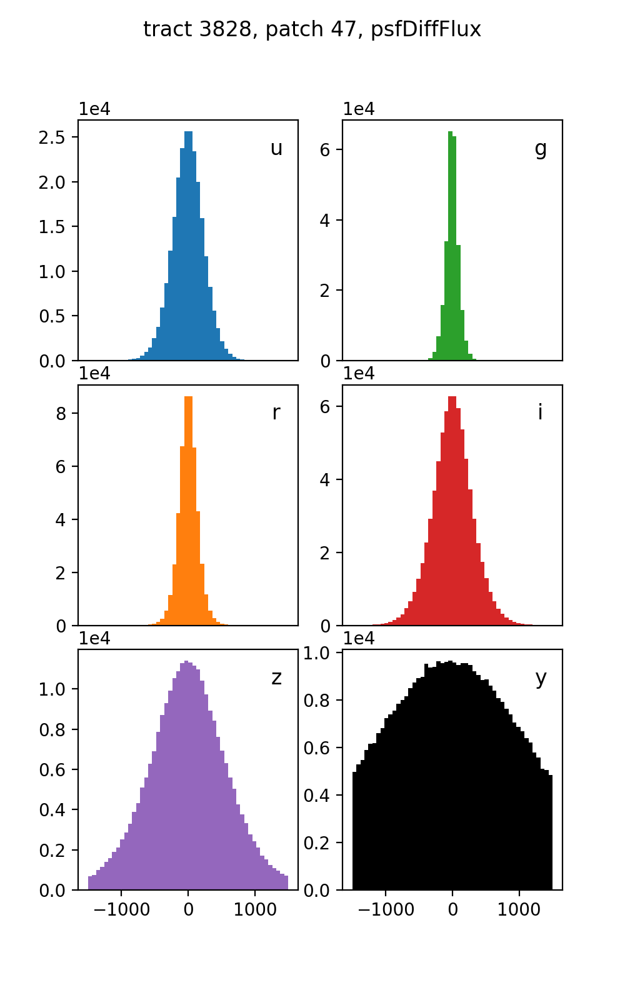

In [27]:
plot_flux_histogram_by_band(test_forcedSrc_good, 'psfDiffFlux', num_bins=50, histrange=(-1.5e3, 1.5e3), sharey=False,
                            title='tract 3828, patch 47, psfDiffFlux')

## Load up more than one patch worth of forcedSourceTable

Loading up a whole tract uses too much memory, so we'll have to live with ~5 patches each for now

In [8]:
def loadMultiplePatches(collections, tract, patches, skymap, instrument,
                        columnList=["band", "psfFlux", "psfFluxErr", "objectId", \
                                    "ccdVisitId", "detect_isTractInner", "detect_isPatchInner"],
                        returnGood=True):
    """Load forced source table data from one or more patches for light curve analysis.
    
    Parameters
    ----------
    collections :  `str`
    tract : `int`
    patches : `list` or `int`
        If iterable, use patches directly in for loop. If not, loop from 0 to patches.
    skymap : `str`
    instrument : `str`
    columnList : `list`, optional
        Must include 'ccdVisitId', `detect_isTractInner`, and `detect_isPatchInner`.
        Almost certainly ought to include `band`, `objectId`, flux, and flux error.
        Keep this list as short as possible for memory's sake.
    returnGood : `bool`, optional
        If True (default), return only sources within inner patches and inner tracts. Else, return all sources.
        
    Returns
    -------
    forcedSrcList : `pd.DataFrame`
        Forced source table containing columns in columnList (from forcedSourceTables)
        plus expMidpt (from ccdVisitTables).
    """
    try:
        test_patches_iter = iter(patches)
    except TypeError:
        print(f'Loading all patches in tract {tract} from 0 to {patches}')
        patches = range(patches)
    forcedSrcList = pd.DataFrame()
    for patch in patches:
        forcedSrc = butler.get('forcedSourceTable', collections=collections, tract=tract, patch=patch,
                               skymap=skymap, instrument=instrument, parameters={"columns": columnList})
        # Retrieve expMidpt info from ccdVisitTable
        ccdVisitTable = butler.get('ccdVisitTable', collections=collections, tract=tract, patch=patch,
                                   skymap=skymap, instrument=instrument,
                                   parameters={"columns": ['ccdVisitId', 'expMidpt']})
        forcedSrc['forcedSourceId'] = forcedSrc.index
        forcedSrcWithTime = pd.merge(forcedSrc, ccdVisitTable['expMidpt'], \
                                     on='ccdVisitId', how='left').set_index('forcedSourceId')
        forcedSrcList = forcedSrcList.append(forcedSrcWithTime)

    if returnGood:
        forcedSrcList_good = forcedSrcList.loc[(forcedSrcList['detect_isTractInner'] == True) & \
                                               (forcedSrcList['detect_isPatchInner'] == True)]
        print(f'Loaded {len(forcedSrcList_good)} forced sources from inner patches and inner tracts.')
        return forcedSrcList_good.loc[:, ~forcedSrcList_good.columns.isin(['detect_isTractInner', \
                                                                           'detect_isPatchInner'])]

    else:
        print(f'Loaded {len(forcedSrcList)} forced sources.')
        return forcedSrcList

### A chunk of tract 3828

In [20]:
forcedSrc3828 = loadMultiplePatches(collection1, 3828, 5, skymap, instrument)

Loading all patches in tract 3828 from 0 to 5
Loaded 10679300 forced sources from inner patches and inner tracts.


/tmp/ipykernel_6583/1931563350.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axs = plt.subplots(3, 2, figsize=(5,8), sharey=sharey)


<IPython.core.display.Javascript object>


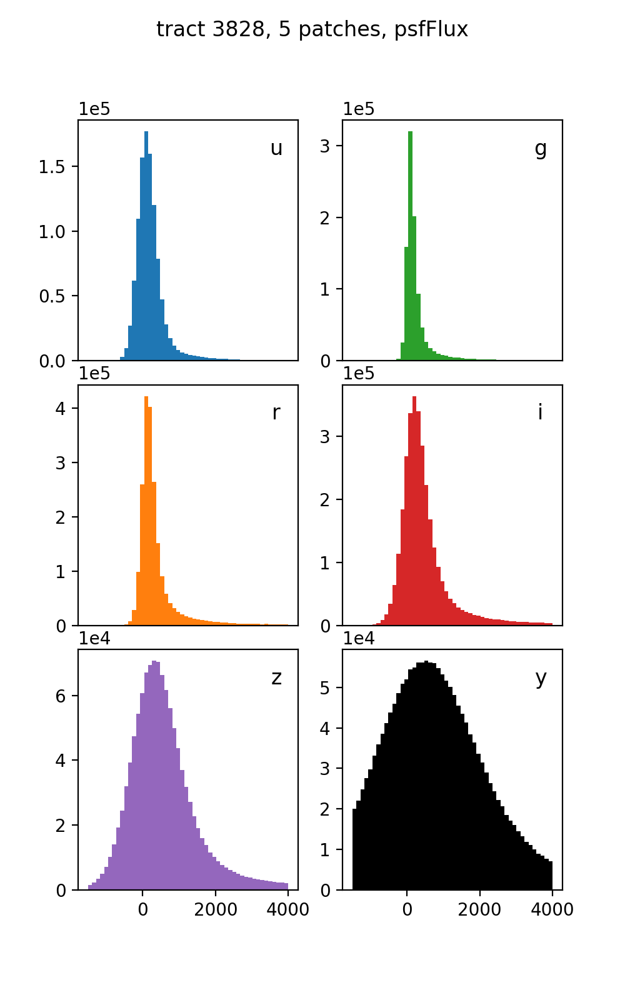

In [23]:
plot_flux_histogram_by_band(forcedSrc3828, 'psfFlux', num_bins=50, sharey=False, 
                            title='tract 3828, 5 patches, psfFlux')

In [25]:
objectList3828 = list(set(forcedSrc3828.objectId))
print(len(objectList3828))

111958


<IPython.core.display.Javascript object>


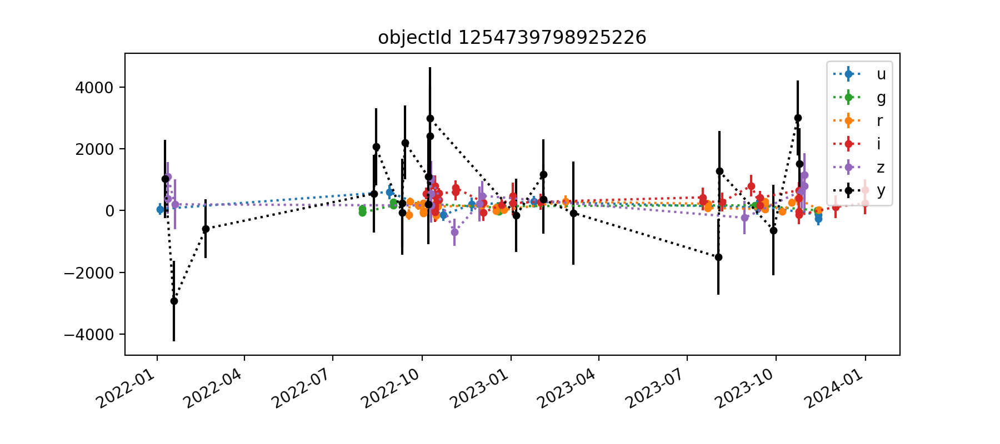

band nobs CV MAD
----------------
u 9 2.572 182.50
g 9 1.141 79.85
r 26 1.207 129.29
i 30 0.730 173.37
z 13 1.300 313.84
y 21 2.185 729.35


<IPython.core.display.Javascript object>


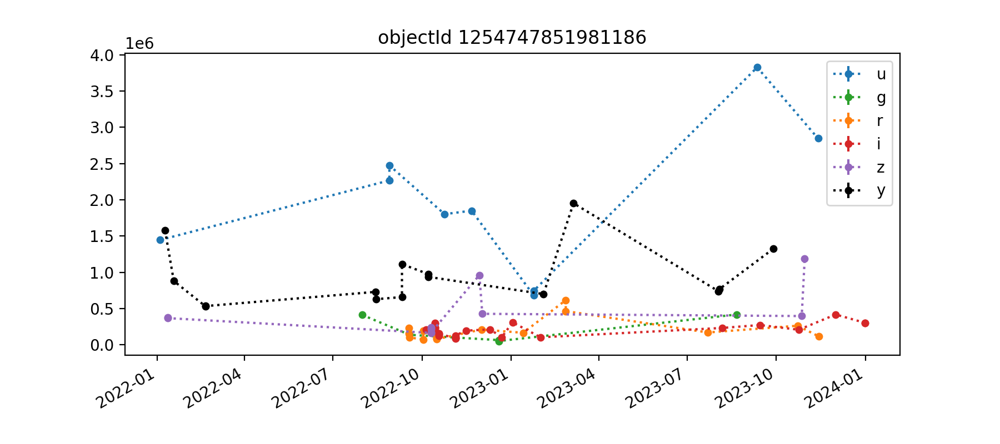

band nobs CV MAD
----------------
u 9 0.537 625180.24
g 6 1.050 52282.65
r 16 0.692 58884.94
i 27 0.443 80011.11
z 10 0.726 146840.97
y 15 0.408 169556.07


<IPython.core.display.Javascript object>


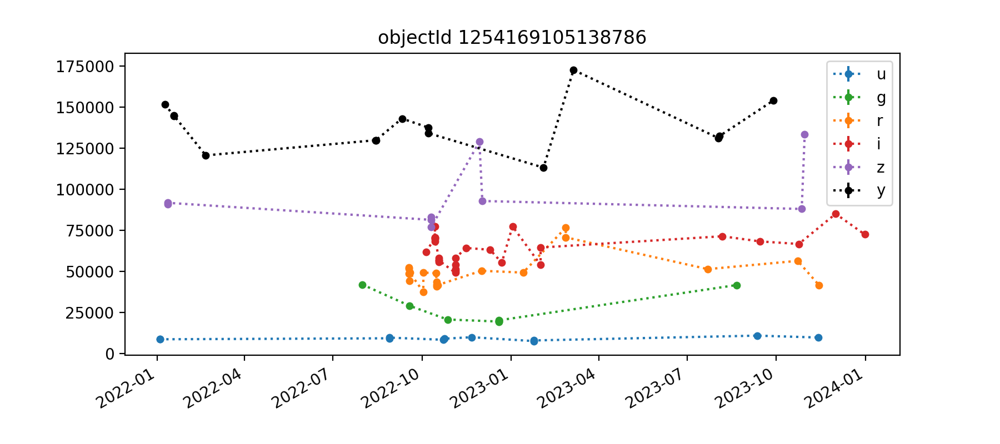

band nobs CV MAD
----------------
u 11 0.099 667.25
g 8 0.339 1066.77
r 19 0.181 5054.06
i 27 0.140 7102.03
z 9 0.188 7858.88
y 14 0.103 7909.18


<IPython.core.display.Javascript object>


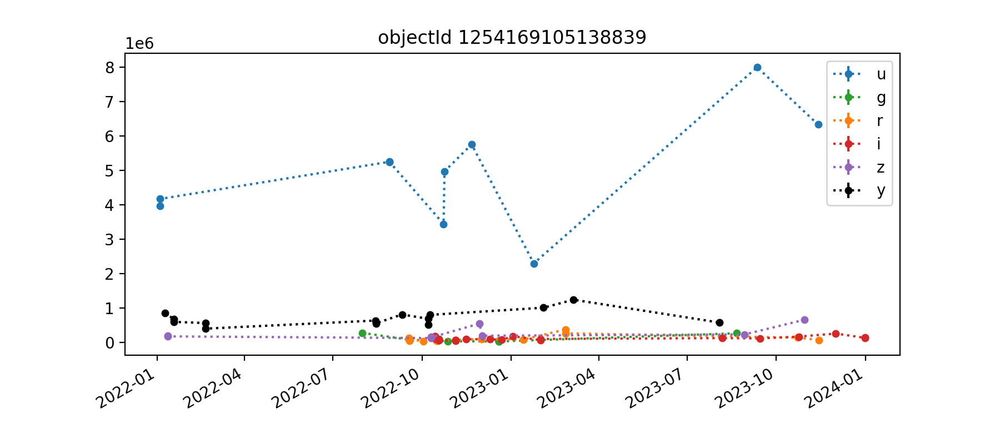

band nobs CV MAD
----------------
u 10 0.322 1045254.11
g 9 1.020 11323.44
r 17 0.685 32414.16
i 26 0.405 33132.56
z 9 0.631 40882.08
y 14 0.293 121620.52


<IPython.core.display.Javascript object>


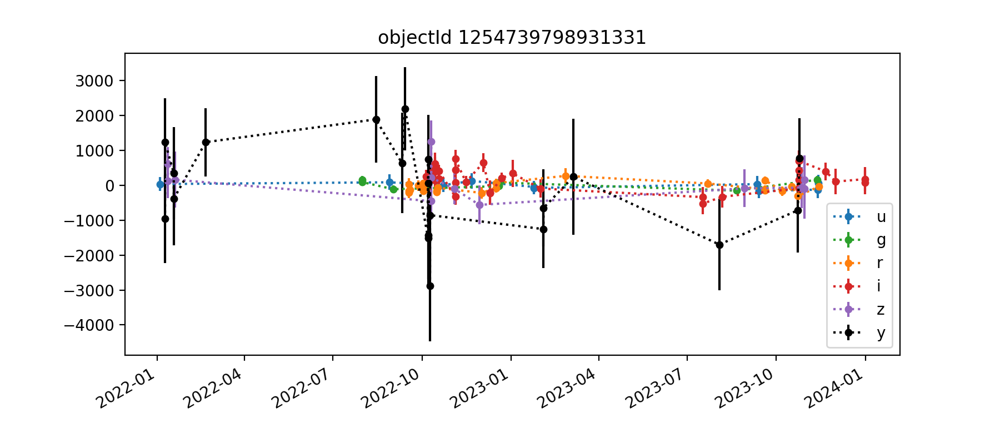

band nobs CV MAD
----------------
u 10 13.499 66.07
g 9 2.585 73.01
r 23 1.784 90.92
i 30 1.716 236.67
z 12 4.783 131.65
y 20 13.623 924.57


<IPython.core.display.Javascript object>


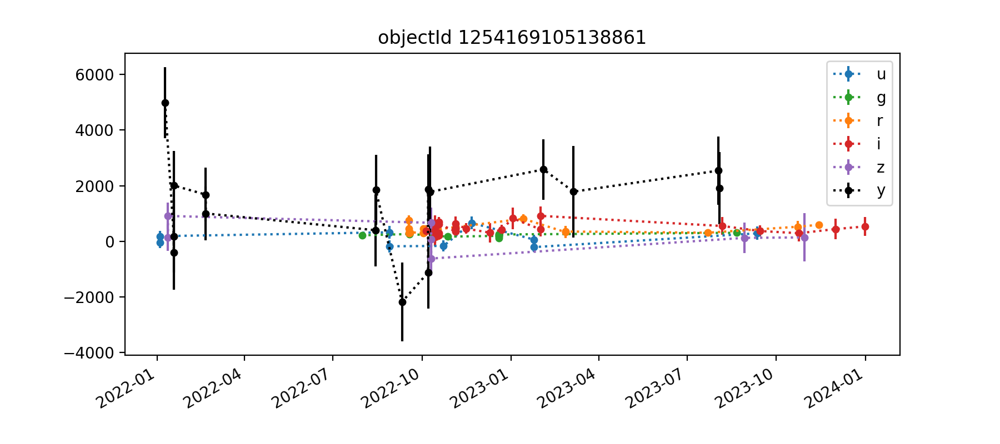

band nobs CV MAD
----------------
u 9 3.040 230.40
g 9 0.244 44.17
r 18 0.404 90.25
i 28 0.368 111.89
z 7 1.934 63.32
y 16 1.178 769.70


<IPython.core.display.Javascript object>


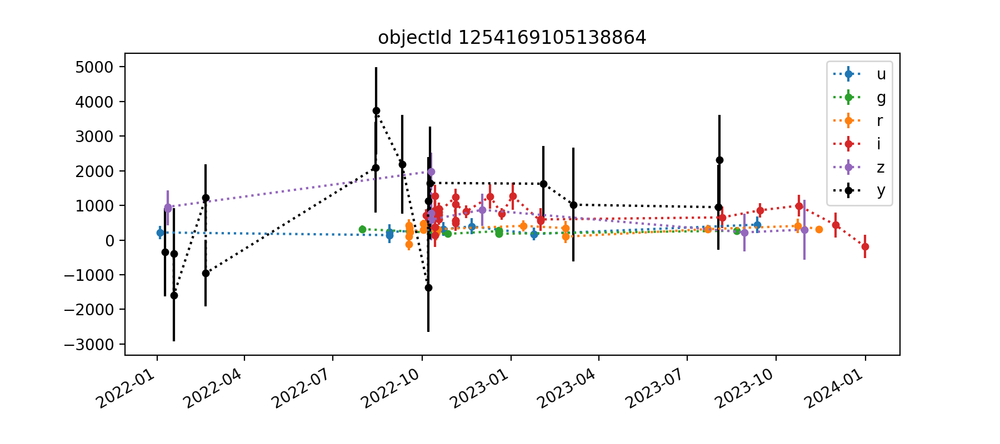

band nobs CV MAD
----------------
u 8 0.394 66.79
g 9 0.187 27.70
r 17 0.447 81.73
i 28 0.393 193.66
z 8 0.579 183.84
y 15 1.736 1050.78


<IPython.core.display.Javascript object>


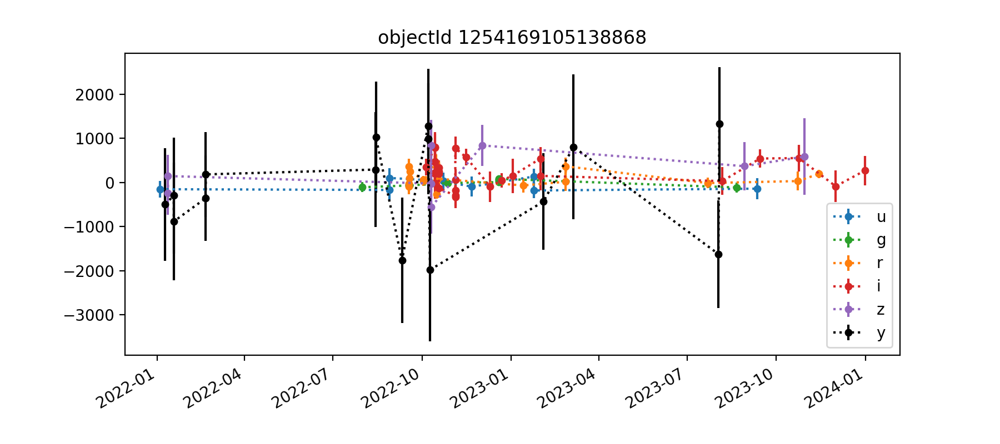

band nobs CV MAD
----------------
u 8 2.149 57.47
g 9 4.809 58.95
r 17 2.155 74.63
i 28 1.327 257.08
z 8 2.008 416.05
y 15 9.386 1104.45


<IPython.core.display.Javascript object>


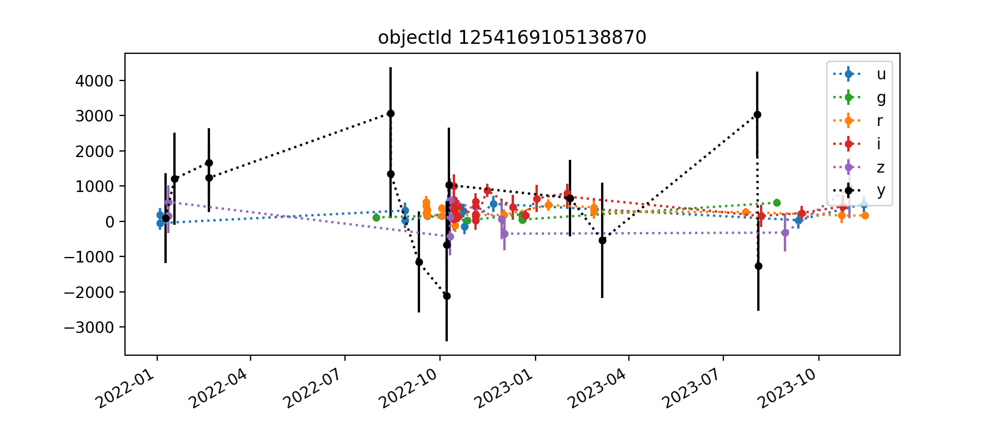

band nobs CV MAD
----------------
u 9 1.255 153.23
g 9 1.013 61.50
r 19 0.520 69.41
i 23 0.684 235.74
z 9 4.081 438.01
y 14 2.439 1105.03


<IPython.core.display.Javascript object>


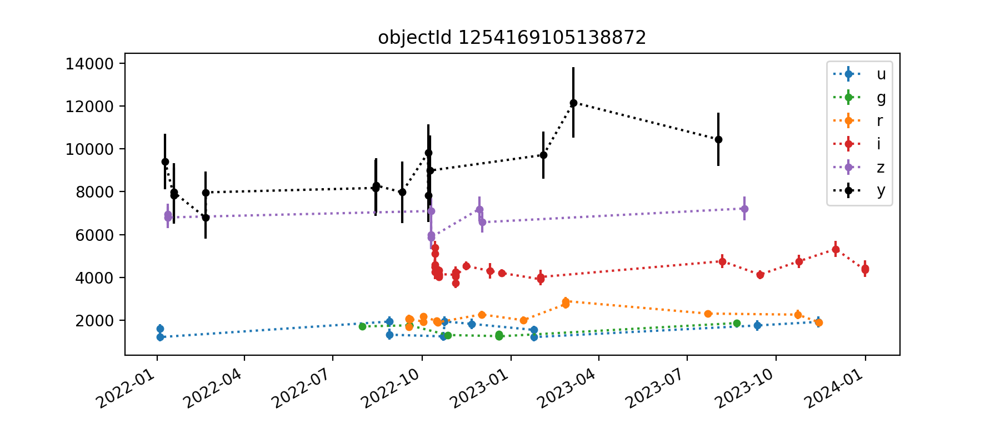

band nobs CV MAD
----------------
u 11 0.184 310.83
g 9 0.148 52.36
r 17 0.124 125.79
i 25 0.088 203.70
z 8 0.071 308.22
y 14 0.149 585.53


<IPython.core.display.Javascript object>


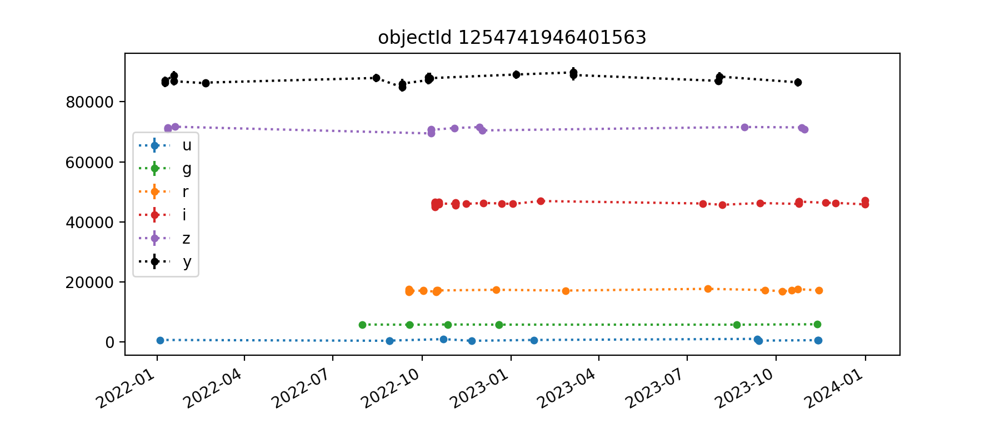

band nobs CV MAD
----------------
u 10 0.314 157.25
g 7 0.007 25.40
r 18 0.015 116.68
i 29 0.009 252.93
z 13 0.008 367.39
y 18 0.014 868.66


<IPython.core.display.Javascript object>


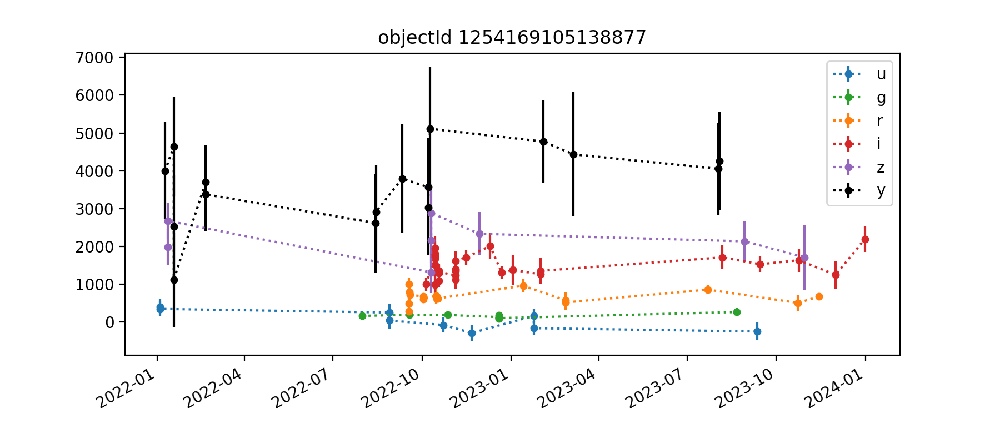

band nobs CV MAD
----------------
u 9 4.246 210.67
g 9 0.307 32.59
r 18 0.221 73.33
i 28 0.198 242.30
z 8 0.216 310.64
y 16 0.268 701.18


<IPython.core.display.Javascript object>


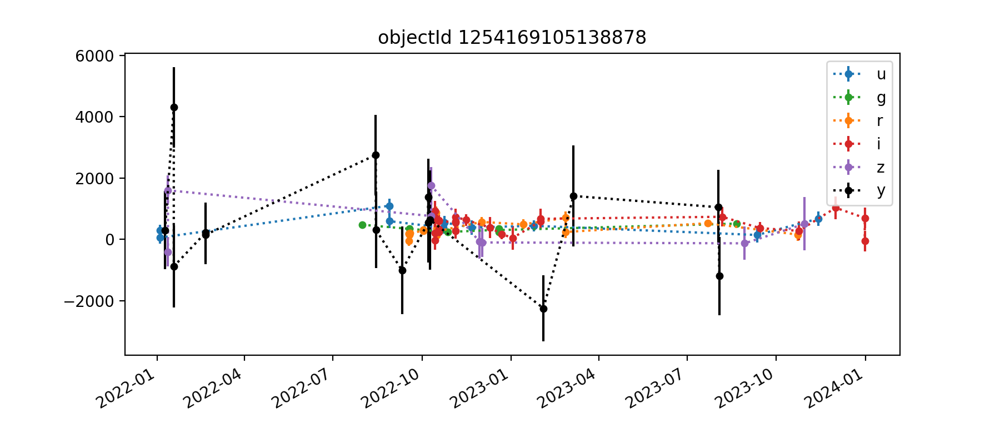

band nobs CV MAD
----------------
u 10 0.613 155.12
g 9 0.238 30.04
r 17 0.661 110.97
i 26 0.546 177.00
z 8 1.705 445.67
y 15 3.372 1064.37


<IPython.core.display.Javascript object>


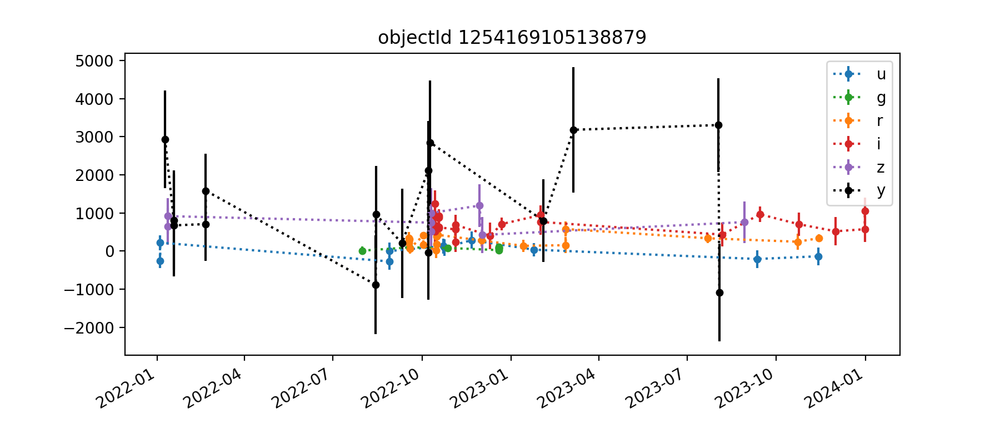

band nobs CV MAD
----------------
u 10 22.670 179.25
g 8 0.420 16.66
r 18 0.456 89.42
i 23 0.310 167.52
z 8 0.311 203.63
y 15 1.138 846.09


<IPython.core.display.Javascript object>


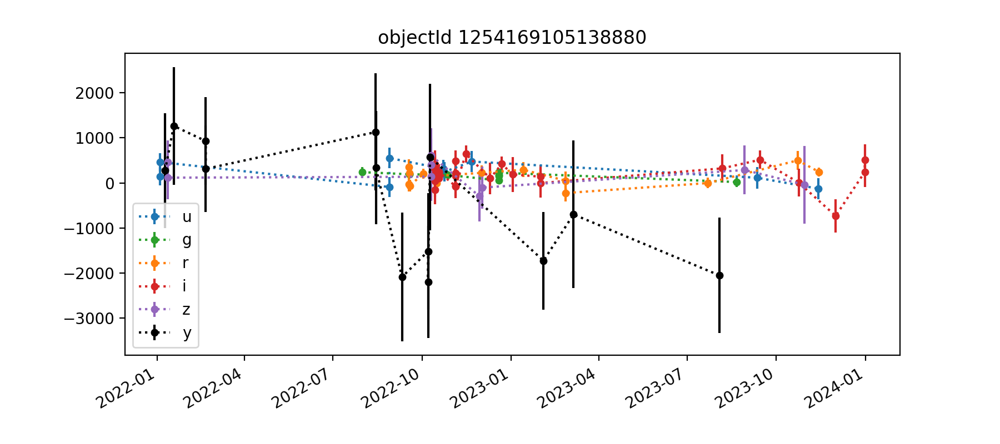

band nobs CV MAD
----------------
u 9 0.968 215.98
g 9 0.411 46.13
r 17 1.088 122.27
i 28 1.198 123.58
z 9 1.548 241.15
y 13 3.266 975.23


<IPython.core.display.Javascript object>


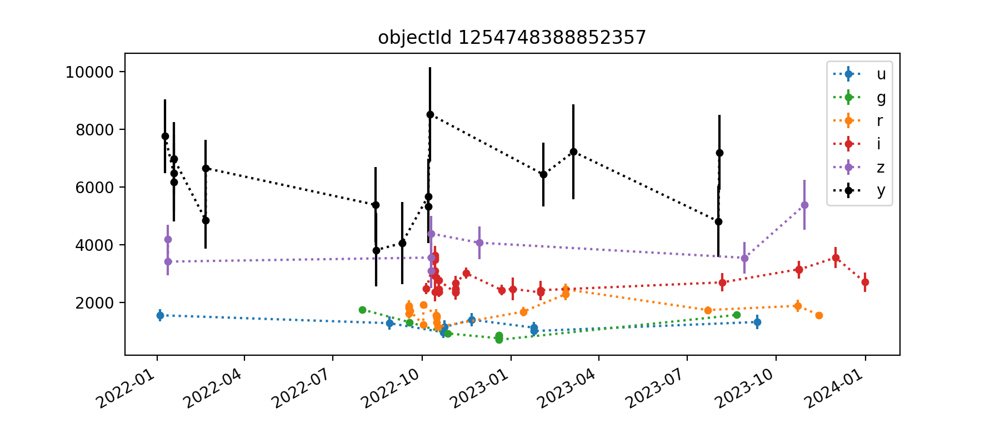

band nobs CV MAD
----------------
u 8 0.158 146.48
g 9 0.327 96.31
r 17 0.196 202.30
i 26 0.147 215.49
z 8 0.157 391.10
y 16 0.206 921.08


<IPython.core.display.Javascript object>


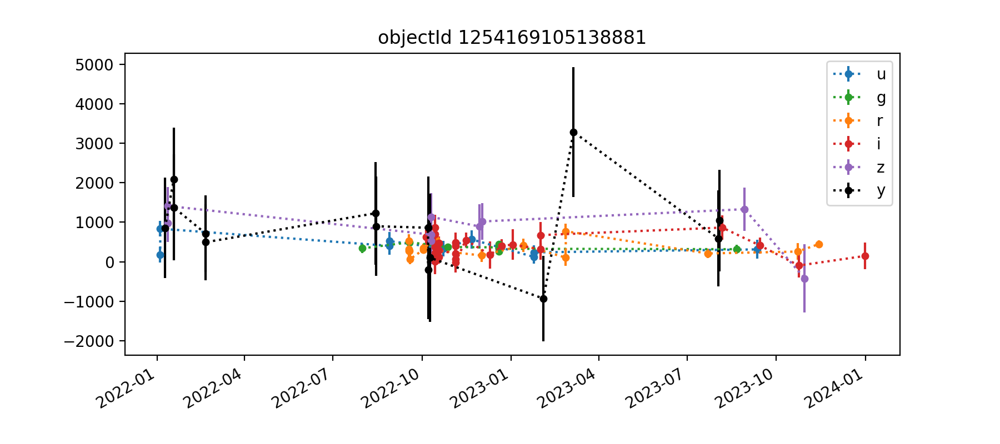

band nobs CV MAD
----------------
u 9 0.566 159.88
g 9 0.171 34.92
r 19 0.449 96.18
i 26 0.682 200.22
z 9 0.503 295.28
y 14 1.124 367.64


<IPython.core.display.Javascript object>


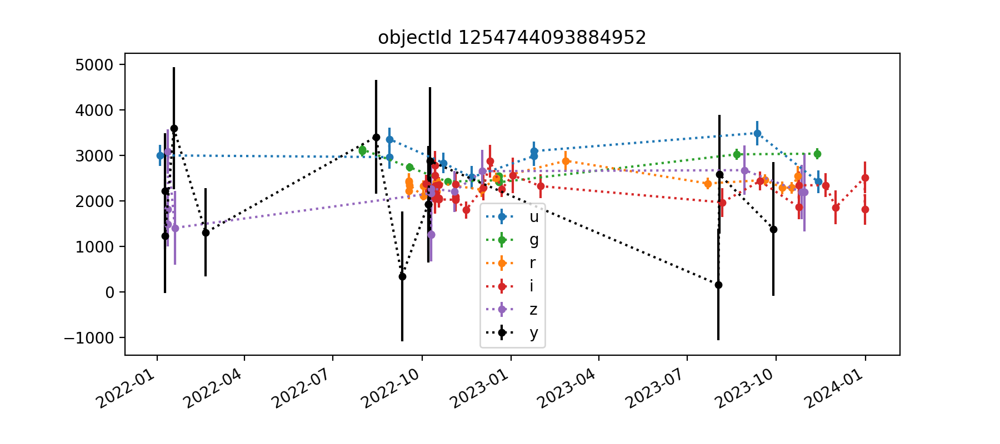

band nobs CV MAD
----------------
u 9 0.107 149.95
g 9 0.105 300.46
r 18 0.064 84.34
i 30 0.112 213.96
z 13 0.266 463.77
y 12 0.551 678.90


<IPython.core.display.Javascript object>


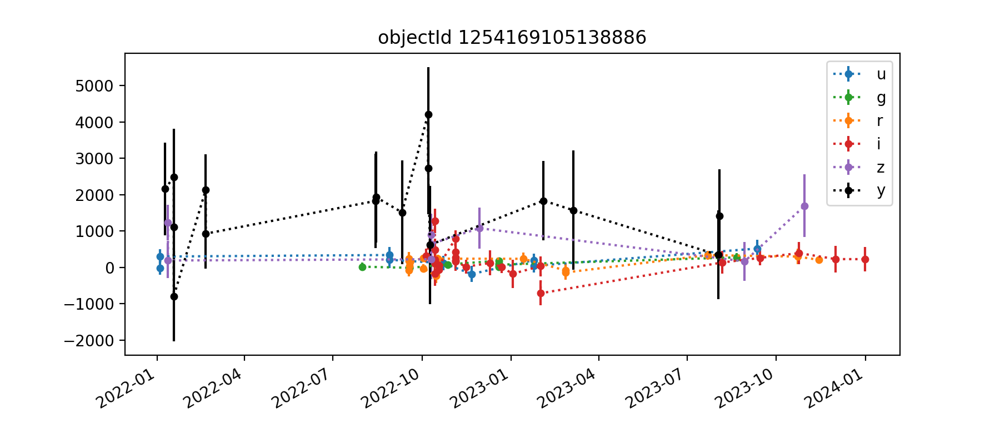

band nobs CV MAD
----------------
u 9 1.167 140.71
g 9 0.937 54.94
r 18 1.158 102.31
i 27 1.819 130.26
z 8 0.701 506.97
y 16 0.661 521.41


<IPython.core.display.Javascript object>


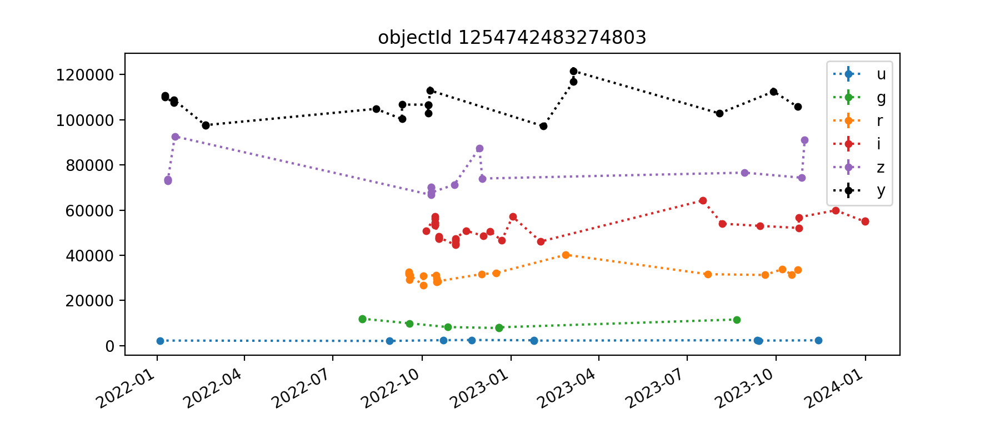

band nobs CV MAD
----------------
u 9 0.052 107.97
g 8 0.180 1161.58
r 19 0.083 655.66
i 29 0.090 4003.52
z 14 0.098 3171.67
y 19 0.059 3856.87


In [26]:
for obj in objectList3828[0:20]:
    result3828 = analyzeObjectLc(obj, forcedSrc3828, doPlot=True, printStats=True)

### A chunk of tract 3829

In [27]:
forcedSrc3829 = loadMultiplePatches(collection1, 3829, 5, skymap, instrument)

Loading all patches in tract 3829 from 0 to 5
Loaded 8686375 forced sources from inner patches and inner tracts.


<IPython.core.display.Javascript object>


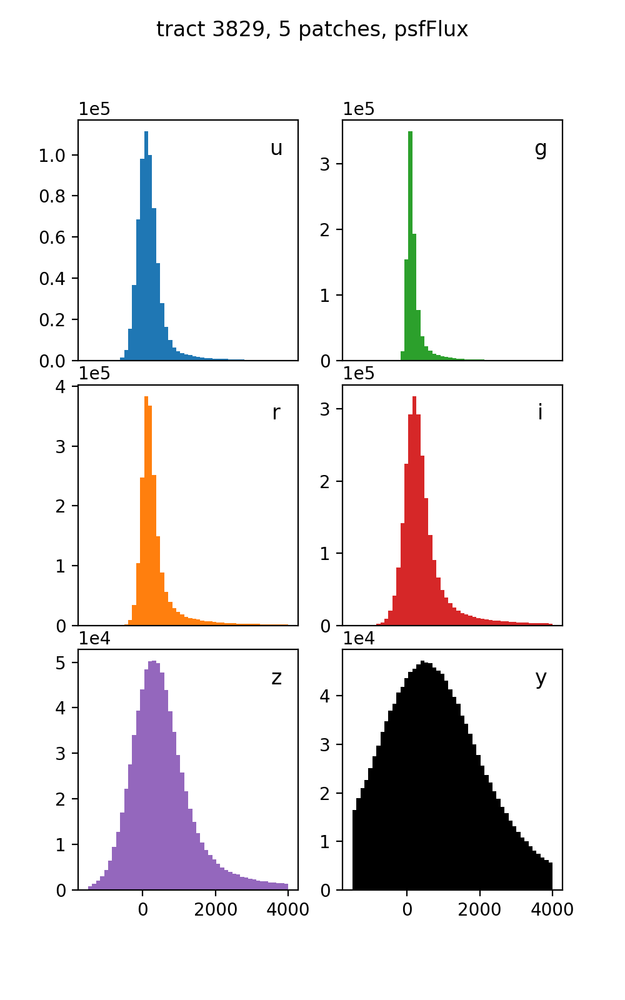

In [28]:
plot_flux_histogram_by_band(forcedSrc3829, 'psfFlux', num_bins=50, sharey=False, 
                            title='tract 3829, 5 patches, psfFlux')

In [29]:
objectList3829 = list(set(forcedSrc3829.objectId))
print(len(objectList3829))

114437


<IPython.core.display.Javascript object>


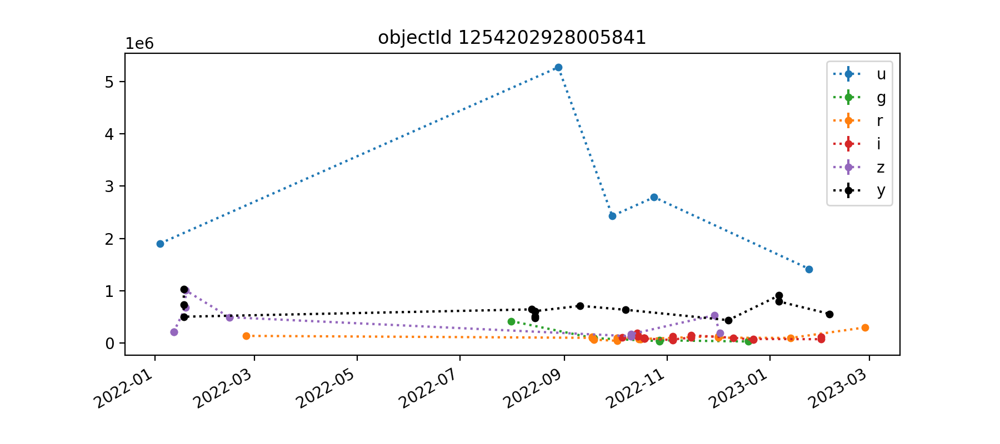

band nobs CV MAD
----------------
u 5 0.474 524849.95
g 8 1.178 7367.44
r 17 0.433 14675.80
i 21 0.305 26510.18
z 10 0.764 80405.85
y 14 0.243 109683.39


<IPython.core.display.Javascript object>


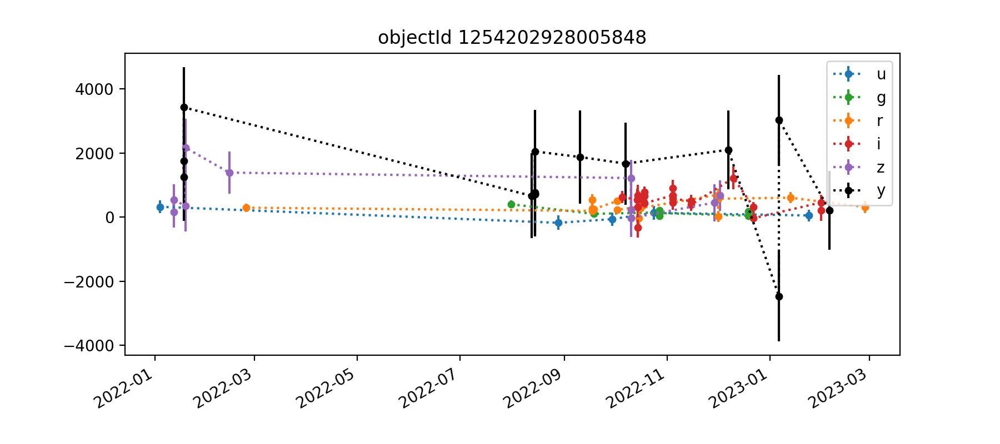

band nobs CV MAD
----------------
u 5 2.807 112.69
g 8 0.651 53.77
r 17 0.528 186.28
i 21 0.577 156.08
z 10 0.891 300.92
y 14 1.048 720.86


<IPython.core.display.Javascript object>


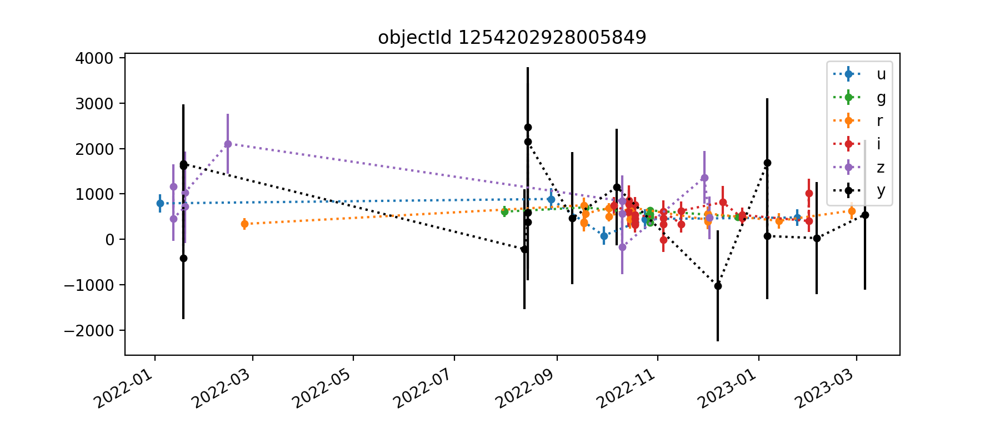

band nobs CV MAD
----------------
u 5 0.537 311.78
g 7 0.195 58.30
r 17 0.240 126.83
i 21 0.402 199.92
z 10 0.694 314.47
y 15 1.343 759.92


<IPython.core.display.Javascript object>


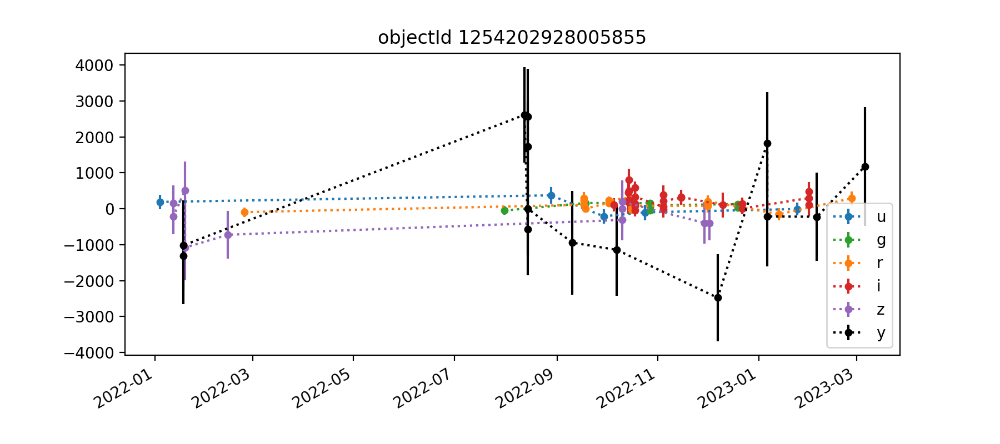

band nobs CV MAD
----------------
u 5 5.026 198.41
g 8 1.082 74.65
r 17 1.105 82.73
i 23 0.864 117.08
z 10 1.919 342.41
y 14 14.274 1009.50


<IPython.core.display.Javascript object>


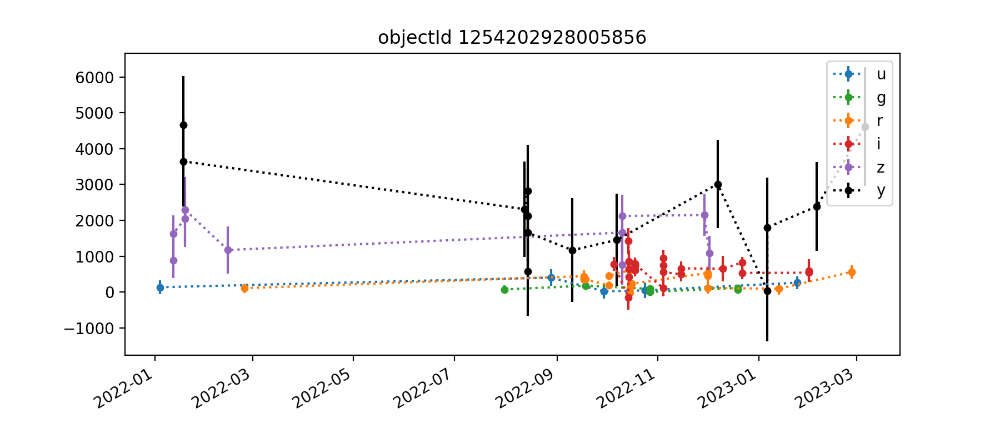

band nobs CV MAD
----------------
u 5 0.801 112.30
g 8 0.676 28.26
r 17 0.565 159.15
i 22 0.388 121.38
z 10 0.349 488.87
y 14 0.562 779.02


<IPython.core.display.Javascript object>


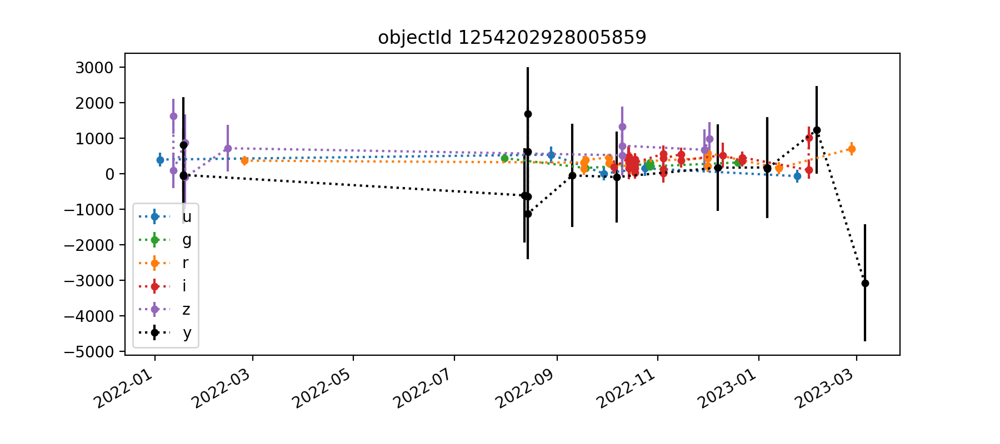

band nobs CV MAD
----------------
u 5 1.199 220.43
g 7 0.248 23.67
r 17 0.424 93.90
i 21 0.623 161.34
z 10 0.616 229.60
y 15 96.296 575.96


<IPython.core.display.Javascript object>


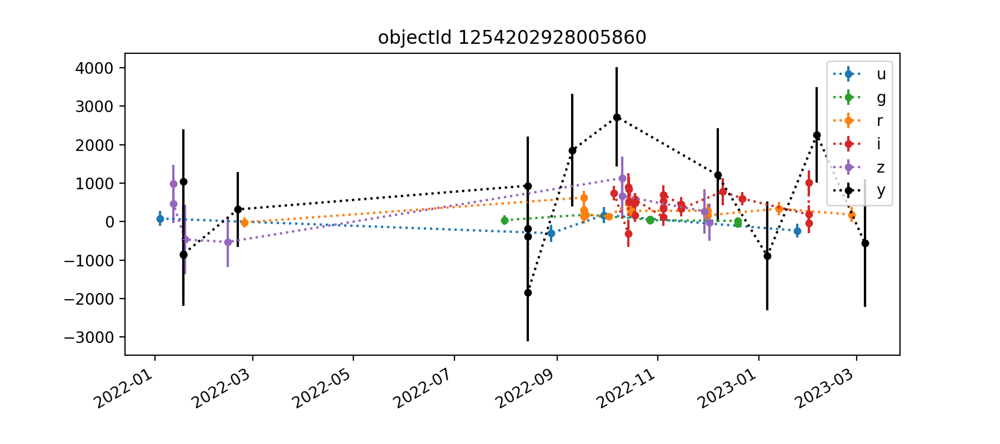

band nobs CV MAD
----------------
u 4 2.814 191.18
g 8 1.384 14.28
r 15 0.582 93.15
i 24 0.561 178.74
z 8 1.487 503.41
y 14 3.655 942.68


<IPython.core.display.Javascript object>


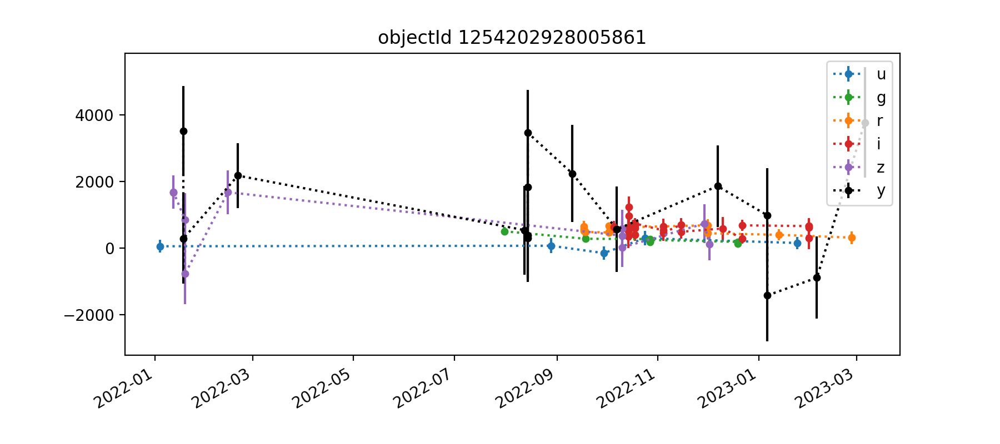

band nobs CV MAD
----------------
u 5 1.672 83.35
g 8 0.367 42.50
r 15 0.182 80.74
i 21 0.323 91.54
z 10 0.980 592.97
y 15 1.142 877.00


<IPython.core.display.Javascript object>


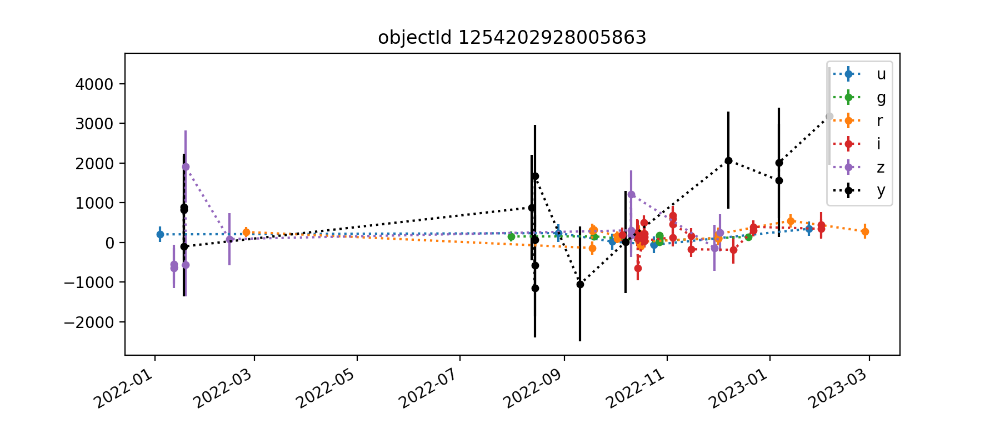

band nobs CV MAD
----------------
u 5 0.976 140.59
g 7 0.542 14.54
r 17 1.037 95.10
i 21 1.188 122.96
z 10 5.329 475.60
y 14 1.679 893.96


<IPython.core.display.Javascript object>


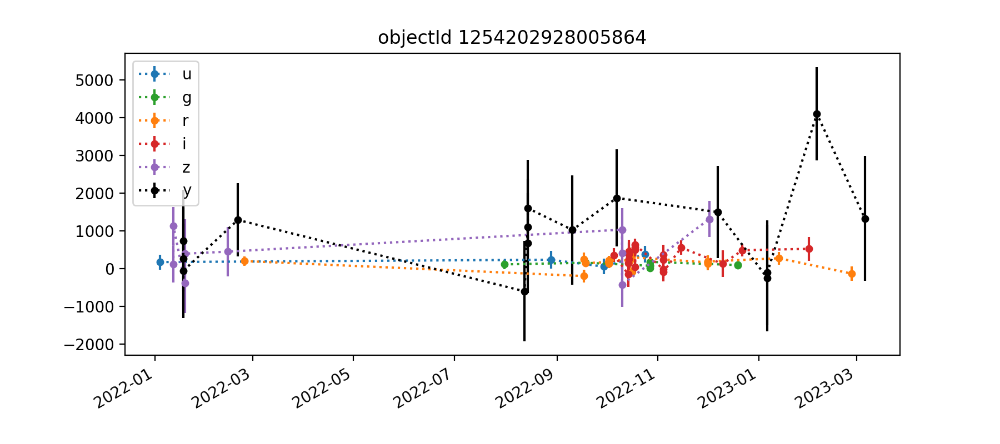

band nobs CV MAD
----------------
u 4 0.567 90.76
g 8 0.467 17.57
r 16 0.984 55.33
i 18 0.717 174.73
z 9 1.179 627.53
y 15 1.121 573.64


<IPython.core.display.Javascript object>


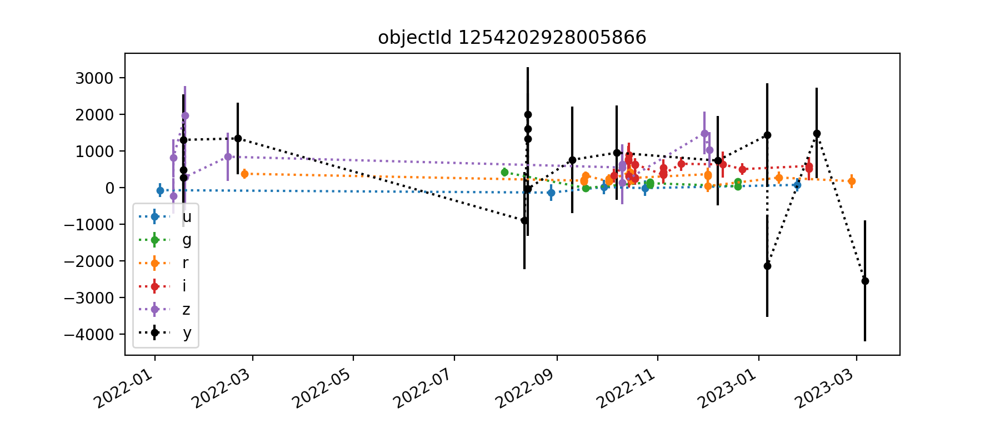

band nobs CV MAD
----------------
u 5 2.875 55.34
g 8 0.823 44.60
r 17 0.365 72.88
i 19 0.358 140.21
z 10 0.821 369.67
y 16 2.123 581.35


<IPython.core.display.Javascript object>


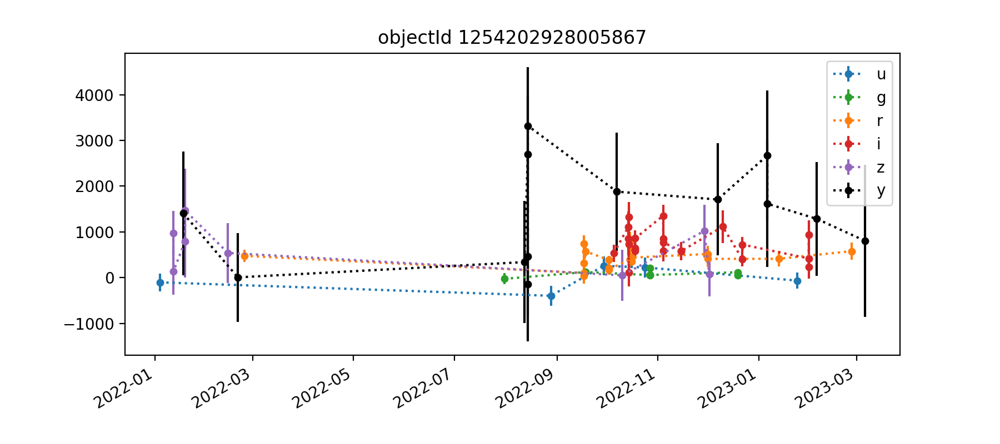

band nobs CV MAD
----------------
u 5 17.551 287.54
g 7 0.669 58.71
r 17 0.465 105.55
i 22 0.409 171.47
z 8 0.826 443.90
y 13 0.779 939.32


<IPython.core.display.Javascript object>


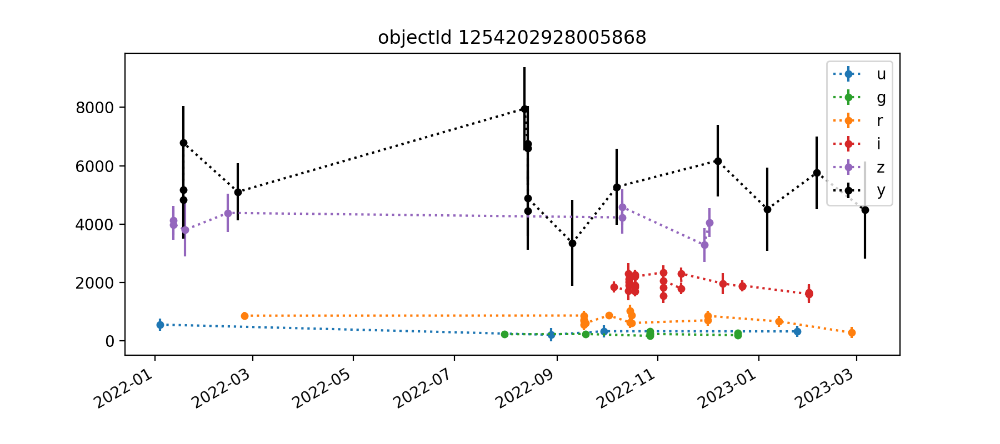

band nobs CV MAD
----------------
u 4 0.347 60.86
g 8 0.188 26.79
r 15 0.228 151.36
i 23 0.120 171.60
z 8 0.089 212.36
y 15 0.203 690.26


<IPython.core.display.Javascript object>


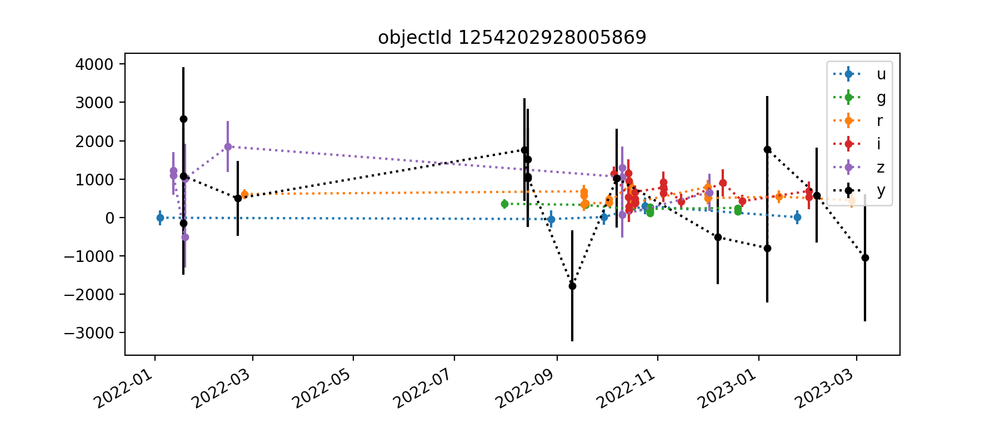

band nobs CV MAD
----------------
u 5 2.402 15.23
g 8 0.333 73.97
r 17 0.287 121.38
i 20 0.427 199.57
z 9 0.689 245.61
y 15 1.860 741.15


<IPython.core.display.Javascript object>


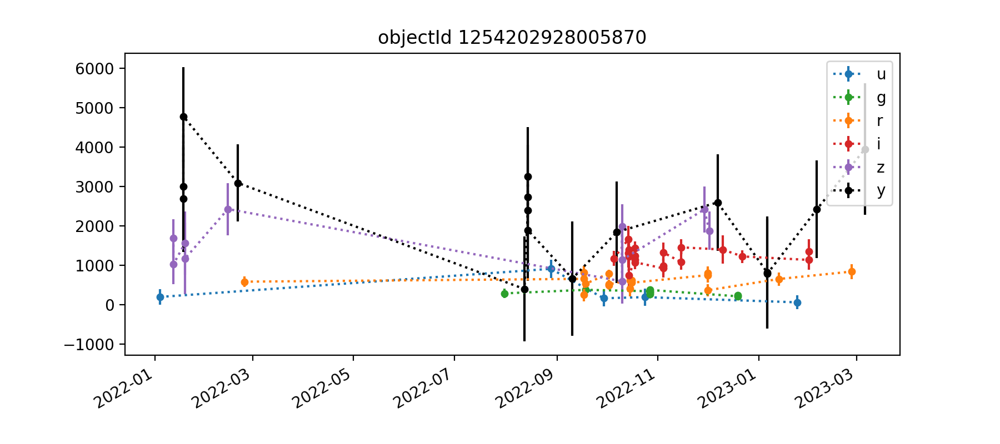

band nobs CV MAD
----------------
u 5 1.037 29.42
g 8 0.193 50.83
r 17 0.253 125.11
i 19 0.158 146.62
z 10 0.362 467.70
y 16 0.493 639.57


<IPython.core.display.Javascript object>


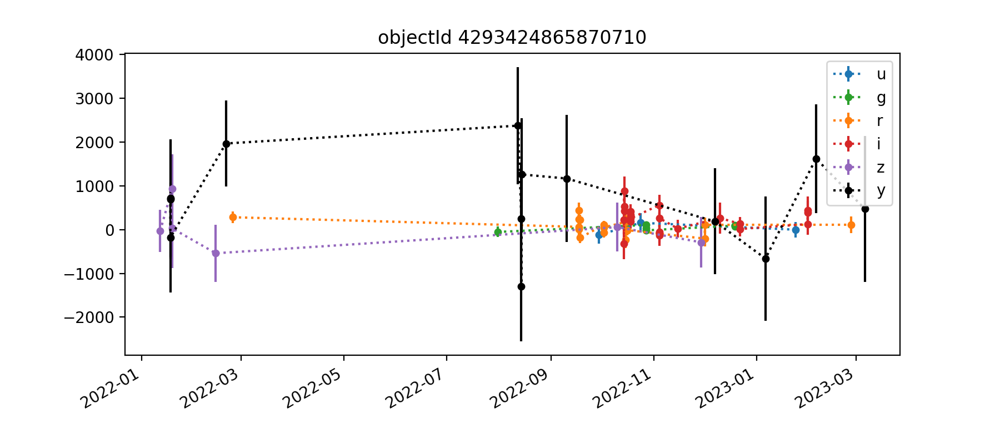

band nobs CV MAD
----------------
u 3 21.936 119.94
g 6 1.119 46.21
r 18 2.415 123.87
i 20 1.033 159.20
z 6 38.980 173.38
y 13 1.480 563.49


<IPython.core.display.Javascript object>


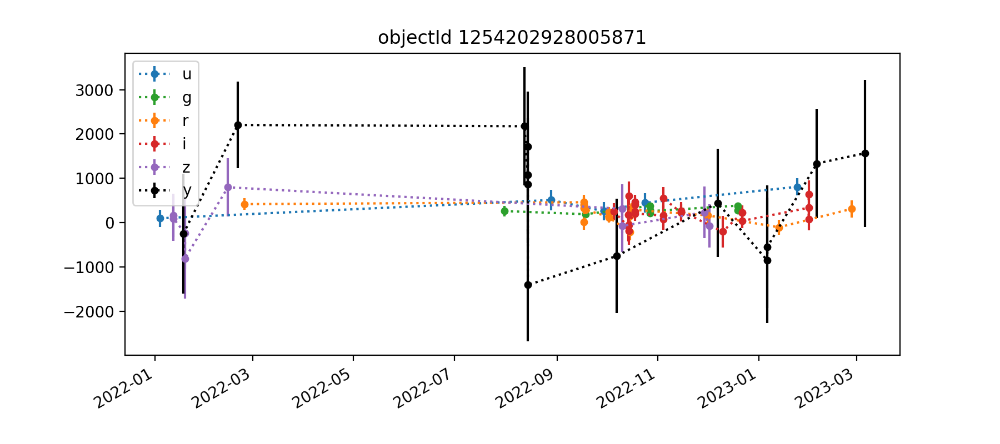

band nobs CV MAD
----------------
u 5 0.583 188.59
g 8 0.226 38.83
r 16 0.760 124.44
i 21 0.922 147.41
z 9 4.477 167.61
y 13 1.915 1111.54


<IPython.core.display.Javascript object>


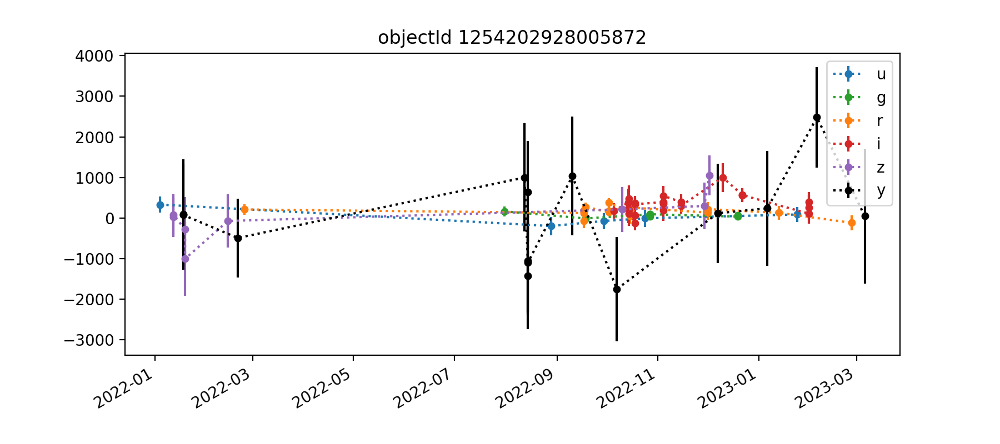

band nobs CV MAD
----------------
u 5 4.833 94.66
g 7 0.677 29.96
r 17 0.694 60.47
i 22 0.677 139.86
z 8 4.095 205.26
y 14 48.401 743.80


<IPython.core.display.Javascript object>


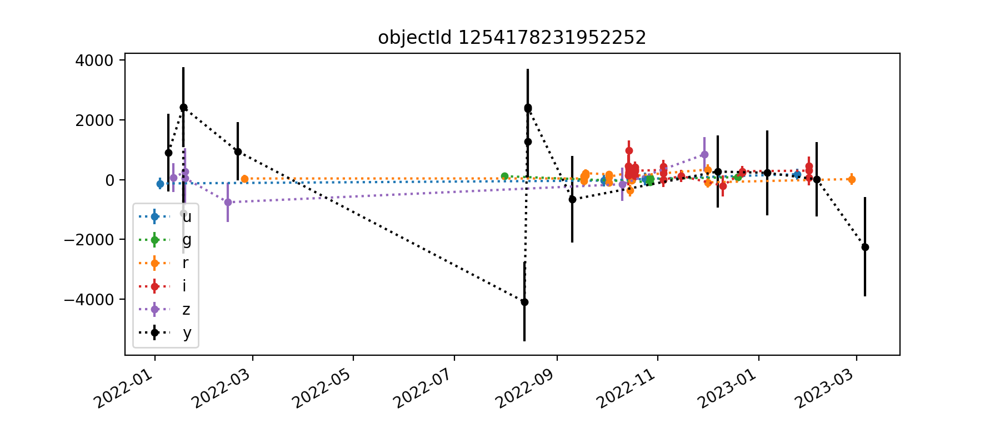

band nobs CV MAD
----------------
u 4 8.505 76.57
g 6 1.535 30.00
r 18 1.927 98.52
i 20 0.728 139.46
z 6 8.576 209.07
y 14 4.072 1482.01


<IPython.core.display.Javascript object>


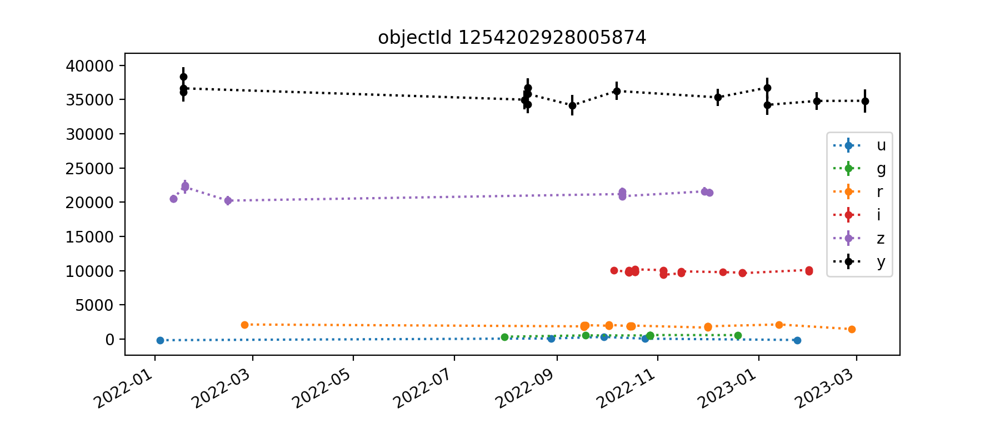

band nobs CV MAD
----------------
u 5 4.101 194.58
g 7 0.120 44.38
r 18 0.078 76.63
i 21 0.020 153.68
z 10 0.031 610.80
y 15 0.032 931.84


In [30]:
for obj in objectList3829[0:20]:
    result3829 = analyzeObjectLc(obj, forcedSrc3829, doPlot=True, printStats=True)

### A chunk of tract 4431

This one is deep, so it's even worse than the others in overflowing all the memory and killing the kernel

In [10]:
#forcedSrc4431 = loadMultiplePatches(collection2, 4431, 3, skymap, instrument)
forcedSrc4431 = loadMultiplePatches(collection2, 4431, [45, 47], skymap, instrument)

Loaded 28270971 forced sources from inner patches and inner tracts.


<IPython.core.display.Javascript object>


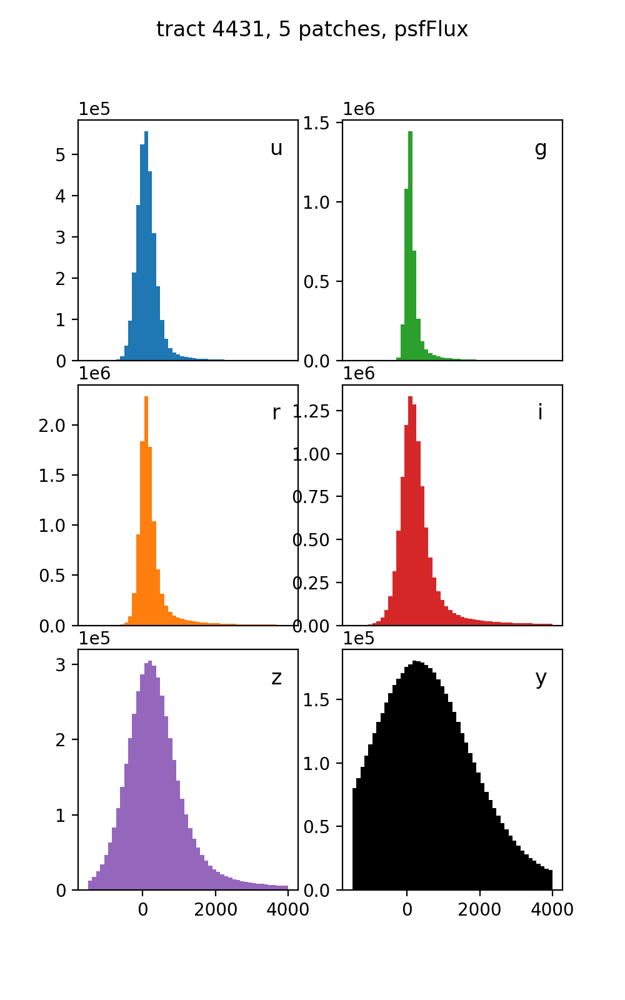

In [10]:
plot_flux_histogram_by_band(forcedSrc4431, 'psfFlux', num_bins=50, sharey=False, 
                            title='tract 4431, 5 patches, psfFlux')

In [12]:
objectList4431 = list(set(forcedSrc4431.objectId))
print(len(objectList4431))

63867


<IPython.core.display.Javascript object>


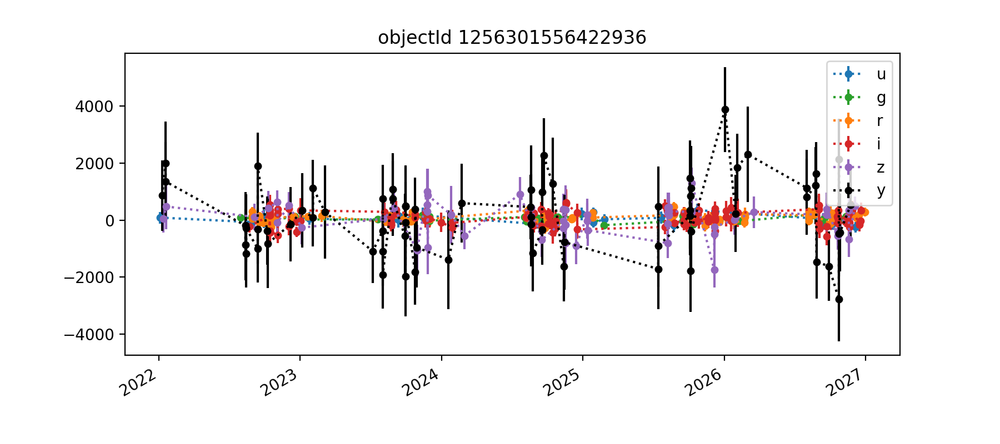

band nobs CV MAD
----------------
u 33 2.947 78.63
g 43 1.502 59.31
r 112 1.652 86.33
i 110 4.933 197.81
z 53 12.786 294.68
y 70 13.321 943.53


<IPython.core.display.Javascript object>


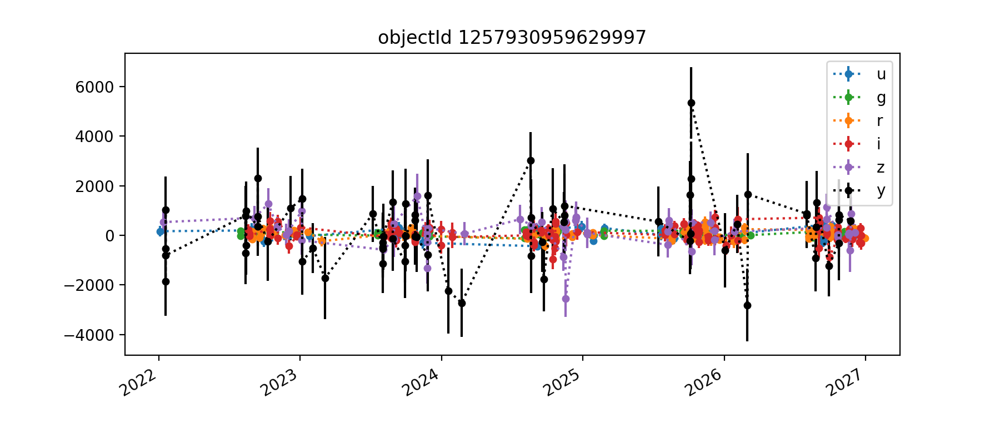

band nobs CV MAD
----------------
u 35 2.606 171.53
g 54 1.261 60.73
r 116 2.206 93.42
i 116 3.497 194.33
z 52 3.027 268.03
y 67 6.144 761.31


<IPython.core.display.Javascript object>


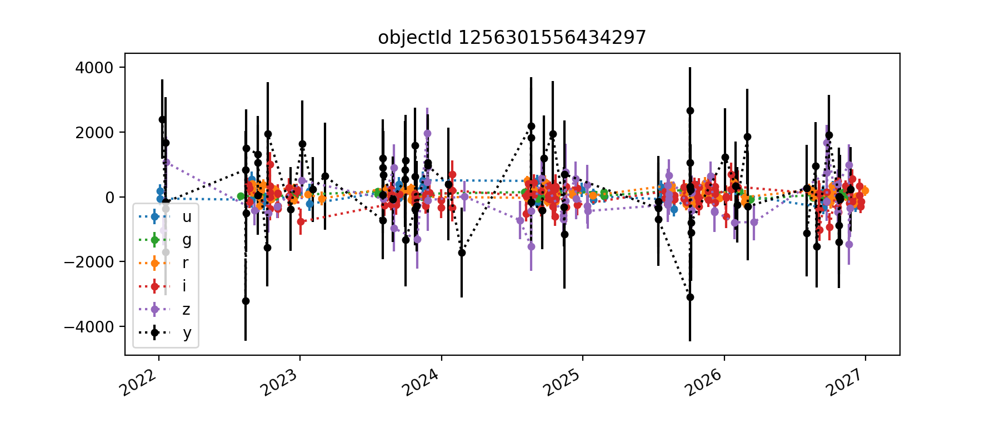

band nobs CV MAD
----------------
u 35 3.425 149.29
g 47 0.782 54.87
r 108 1.700 113.41
i 115 8.508 194.99
z 49 15.027 496.05
y 70 5.436 779.71


<IPython.core.display.Javascript object>


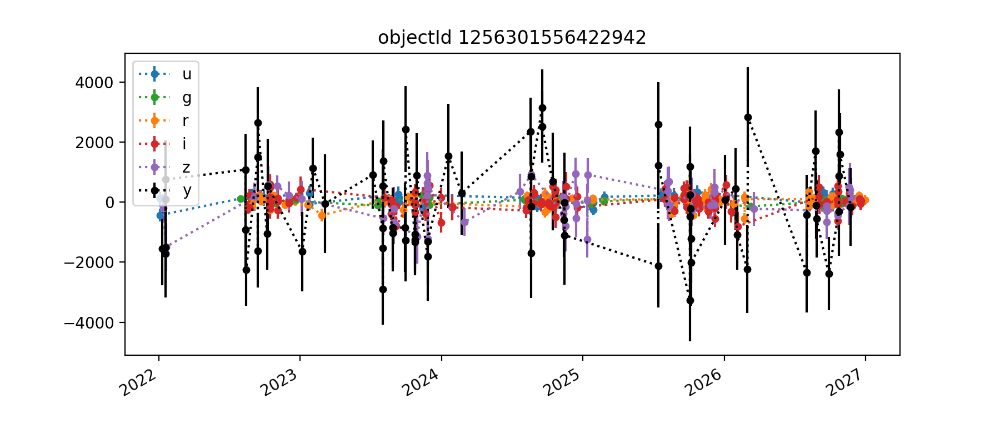

band nobs CV MAD
----------------
u 36 2.487 116.59
g 46 2.732 60.13
r 109 3.569 75.63
i 110 10.847 144.90
z 51 180.668 400.99
y 71 9.674 1099.96


<IPython.core.display.Javascript object>


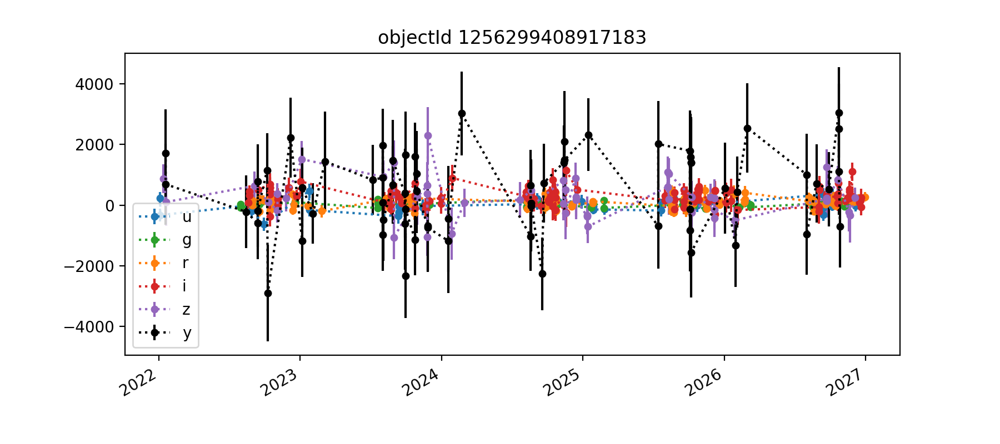

band nobs CV MAD
----------------
u 35 11.467 130.30
g 43 2.025 83.25
r 116 1.405 95.81
i 115 0.935 164.09
z 51 2.189 400.49
y 66 3.080 1016.77


<IPython.core.display.Javascript object>


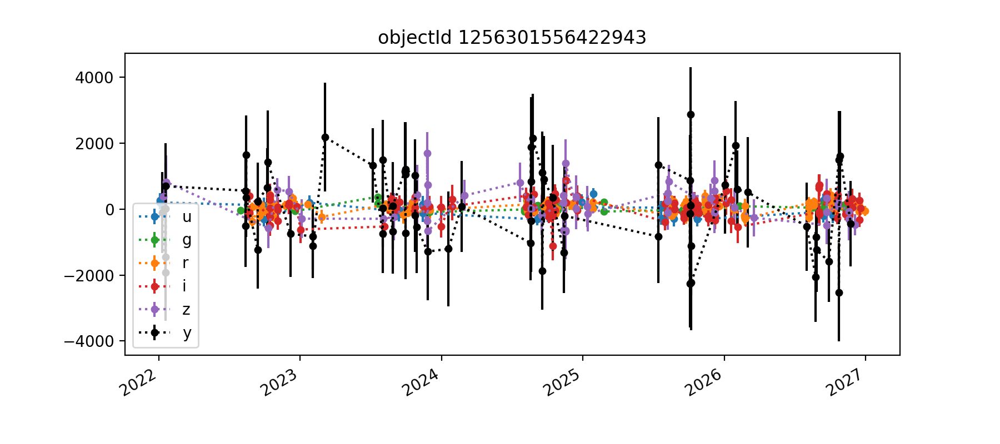

band nobs CV MAD
----------------
u 33 15.969 152.82
g 47 2.397 70.99
r 114 2.521 115.20
i 108 5.922 188.41
z 49 3.178 327.20
y 66 95.747 937.05


<IPython.core.display.Javascript object>


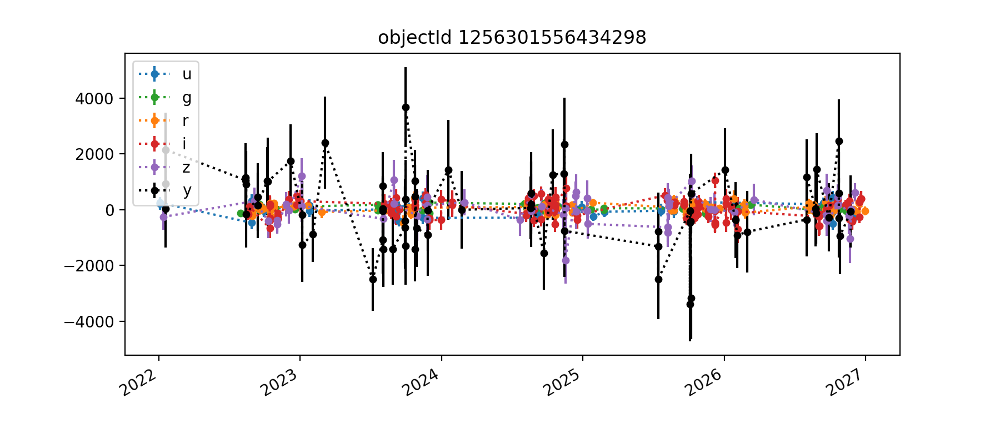

band nobs CV MAD
----------------
u 36 301.544 173.98
g 52 1.521 52.43
r 108 2.481 84.39
i 117 7.103 230.44
z 50 9.682 345.41
y 68 216.751 874.93


<IPython.core.display.Javascript object>


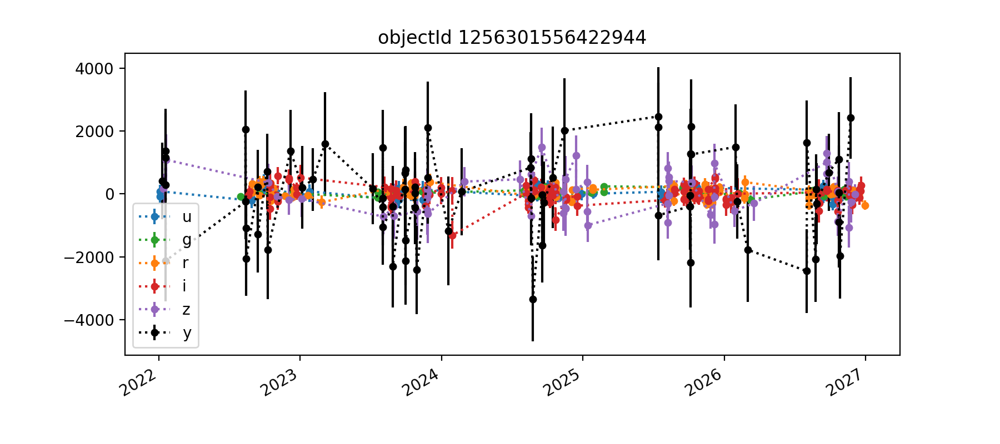

band nobs CV MAD
----------------
u 34 8.763 117.60
g 47 1.991 54.35
r 118 3.078 100.86
i 113 160.226 167.89
z 53 77.872 476.22
y 69 37.437 1039.64


<IPython.core.display.Javascript object>


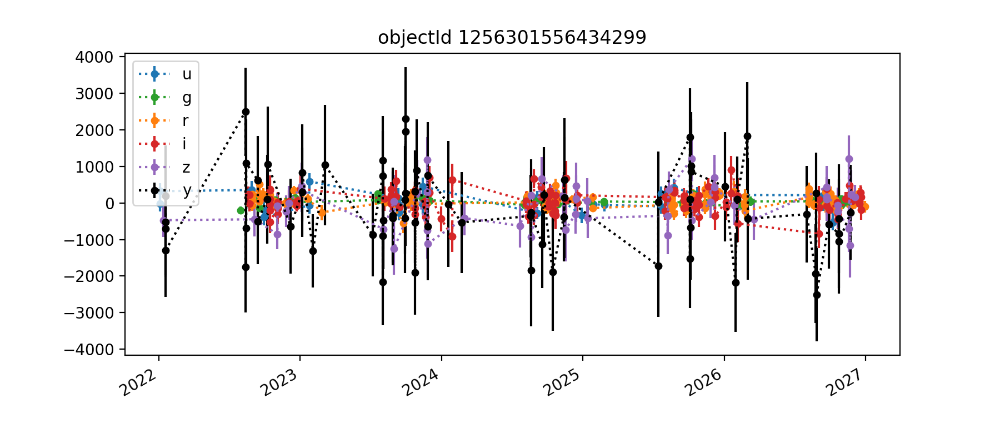

band nobs CV MAD
----------------
u 34 8.754 152.15
g 54 1.805 62.34
r 109 2.252 103.82
i 112 6.557 176.24
z 48 6.849 408.28
y 69 5.185 600.85


<IPython.core.display.Javascript object>


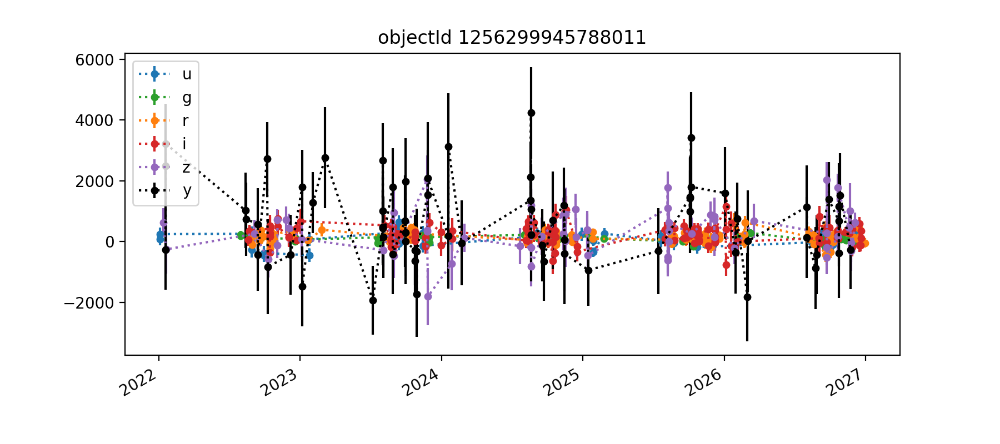

band nobs CV MAD
----------------
u 39 3.807 150.78
g 52 0.856 60.81
r 123 1.067 103.52
i 115 1.225 188.95
z 57 2.020 461.01
y 68 1.951 916.01


<IPython.core.display.Javascript object>


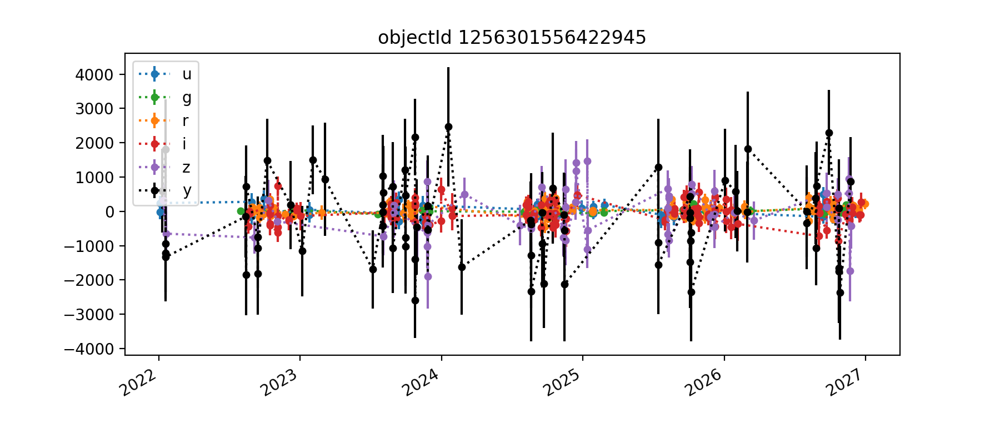

band nobs CV MAD
----------------
u 36 13.808 137.85
g 46 3.626 42.83
r 108 3.304 86.92
i 118 11.292 183.10
z 52 26.829 558.62
y 73 4.164 859.51


<IPython.core.display.Javascript object>


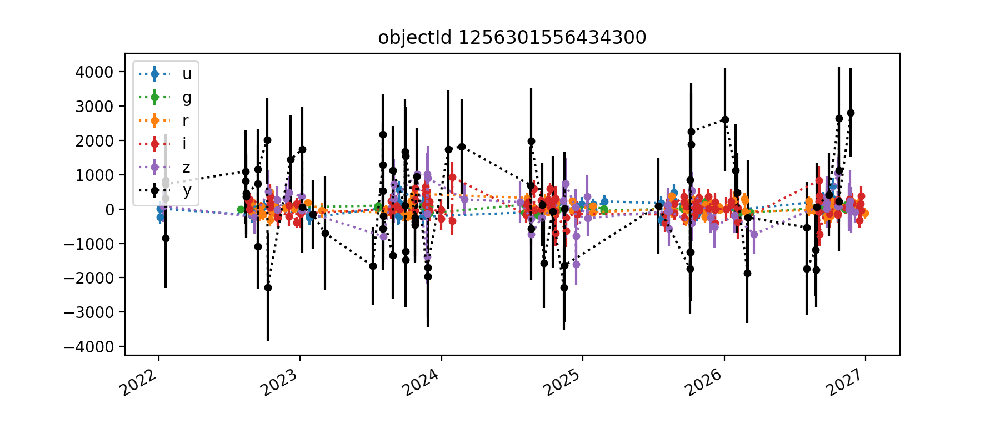

band nobs CV MAD
----------------
u 37 4.148 176.76
g 53 2.896 39.23
r 107 3.095 110.22
i 112 3.193 155.48
z 51 58.768 282.75
y 70 9.320 1002.77


<IPython.core.display.Javascript object>


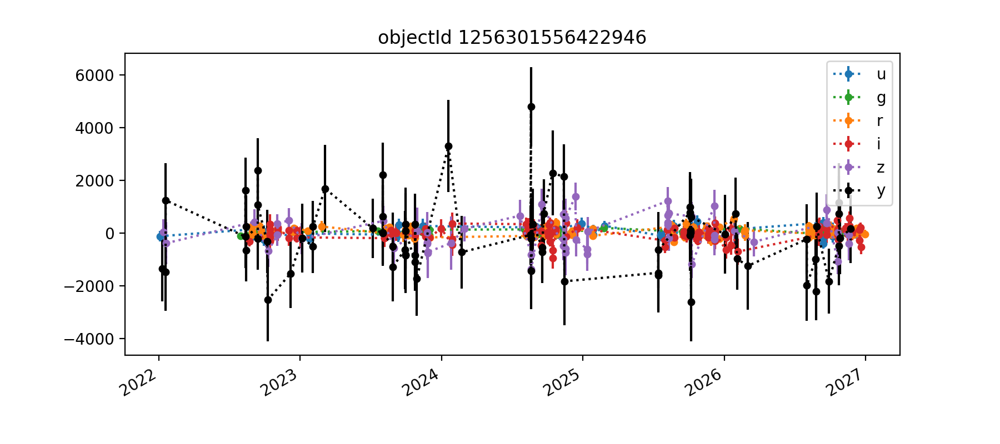

band nobs CV MAD
----------------
u 34 2.970 134.00
g 43 1.417 63.82
r 111 2.317 117.55
i 109 811.822 147.74
z 52 22.475 475.29
y 71 11.244 792.99


<IPython.core.display.Javascript object>


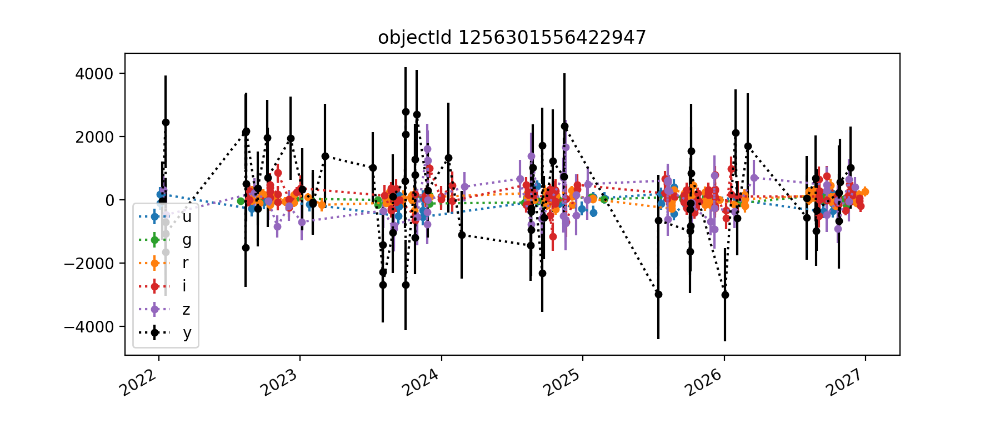

band nobs CV MAD
----------------
u 35 3.435 149.70
g 45 87.872 52.21
r 113 3.499 95.34
i 107 3.896 168.80
z 52 78.962 528.06
y 68 26.544 1004.44


<IPython.core.display.Javascript object>


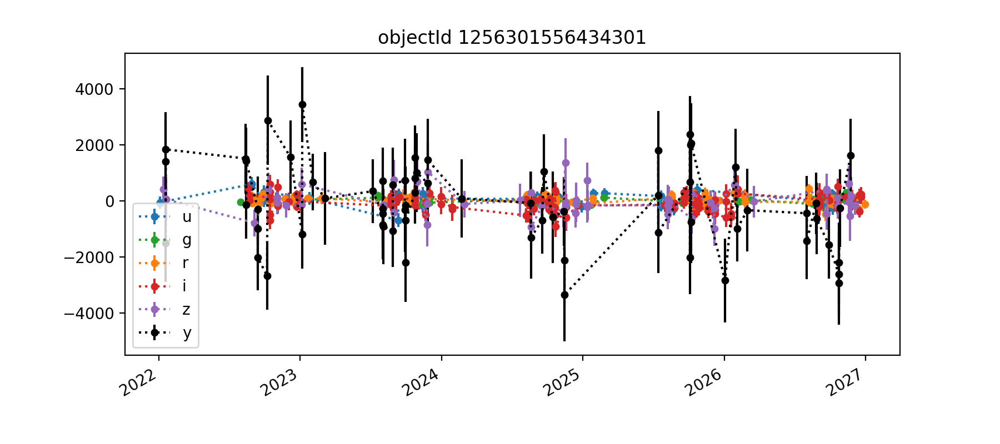

band nobs CV MAD
----------------
u 37 4.065 150.49
g 51 2.137 71.35
r 107 2.872 87.41
i 114 5.583 159.99
z 54 13.763 205.97
y 67 13.559 983.80


<IPython.core.display.Javascript object>


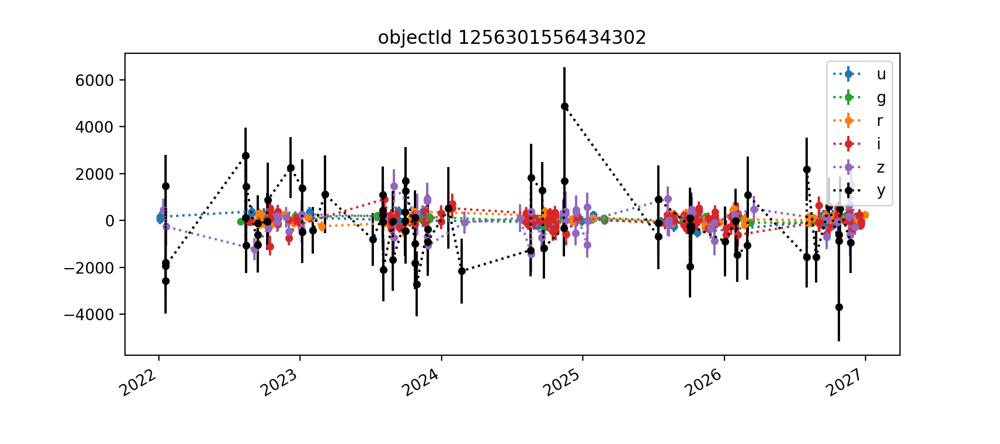

band nobs CV MAD
----------------
u 35 4.240 121.19
g 51 1.513 56.03
r 113 3.207 116.13
i 115 15.996 180.54
z 55 75.023 341.16
y 69 7.049 826.03


<IPython.core.display.Javascript object>


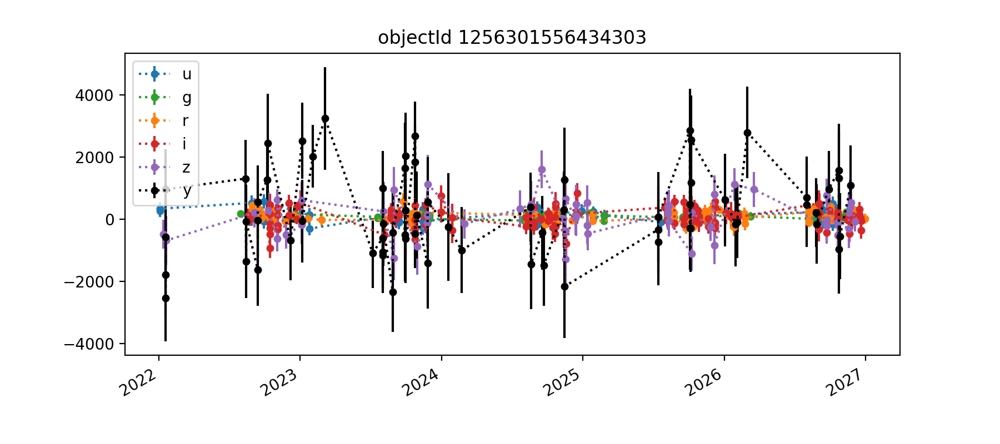

band nobs CV MAD
----------------
u 35 1.846 167.96
g 51 0.848 54.41
r 114 2.152 93.67
i 114 4.555 159.26
z 54 7.521 350.04
y 68 6.430 939.20


<IPython.core.display.Javascript object>


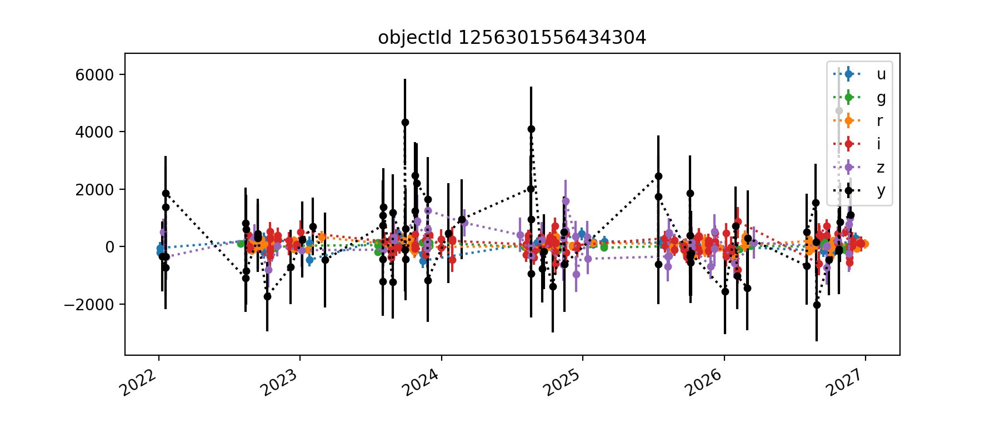

band nobs CV MAD
----------------
u 35 3.426 116.18
g 47 6.261 46.59
r 109 2.269 94.28
i 117 3.099 179.39
z 48 6.127 332.00
y 68 3.697 868.72


<IPython.core.display.Javascript object>


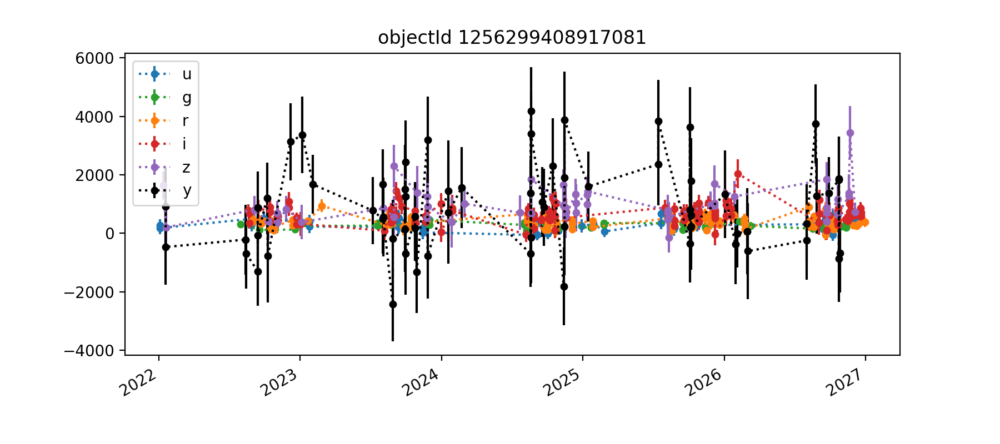

band nobs CV MAD
----------------
u 38 0.668 108.96
g 43 0.352 62.84
r 116 0.449 96.76
i 117 0.429 173.75
z 52 0.566 302.80
y 67 1.706 952.74


/tmp/ipykernel_7847/3857192595.py:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(1,1, figsize=(9,4))


<IPython.core.display.Javascript object>


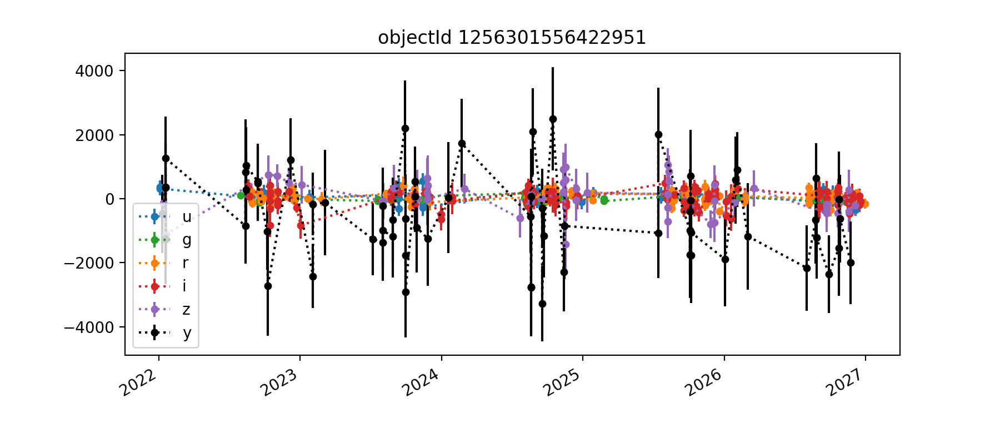

band nobs CV MAD
----------------
u 34 4.179 133.06
g 48 16.648 45.49
r 118 3.007 95.01
i 108 16.303 154.45
z 48 6.385 337.86
y 66 2.343 912.53


In [12]:
for obj in objectList4431[0:20]:
    result4431 = analyzeObjectLc(obj, forcedSrc4431, doPlot=True, printStats=True)

## To do: actual analysis or plot that uses one or more variability metrics

Future work...

In [13]:
forcedSrc4431

,band,psfFlux,psfFluxErr,objectId,ccdVisitId,expMidpt
forcedSourceId,,,,,,
340230162069062059,g,1202.830509,99.885260,1909798920888780399,633728061,2024-08-02 08:42:41.750200
340230162069062062,g,51.588557,94.906069,1909798920888780409,633728061,2024-08-02 08:42:41.750200
340230162069062063,g,297.086379,95.795246,1909798920888780410,633728061,2024-08-02 08:42:41.750200
340230162069062067,g,-122.427704,94.036210,1909798920888780419,633728061,2024-08-02 08:42:41.750200
340230162069062068,g,210.451740,96.146172,1909798920888780423,633728061,2024-08-02 08:42:41.750200
...,...,...,...,...,...,...
655876459079962108,z,119.898353,325.209667,1909816513074878727,1221665105,2026-12-05 01:09:33.571100
655876459079962109,z,-63.888940,323.983588,1909816513074878728,1221665105,2026-12-05 01:09:33.571100
655876459079962110,z,-598.404110,322.158127,1909816513074878730,1221665105,2026-12-05 01:09:33.571100


## Supplementary stuff after notebook was submitted for initial review

In particular, look at tract 4431 objects from some tract other than 0, in the hopes of finding more that aren't just noise-dominated. We should probably do this properly in the future by imposing a signal-to-noise or magnitude faintness cutoff.

In [14]:
# after reloading objectList from different tracts
len(objectList4431)

63867

<IPython.core.display.Javascript object>


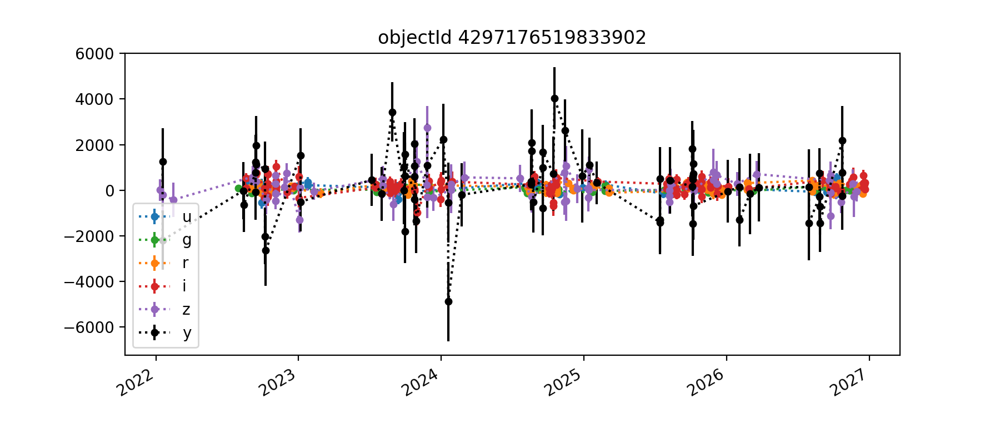

band nobs CV MAD
----------------
u 26 3.518 169.86
g 51 2.079 47.47
r 115 1.394 90.22
i 112 1.526 135.13
z 61 3.469 389.20
y 72 4.549 731.76


<IPython.core.display.Javascript object>


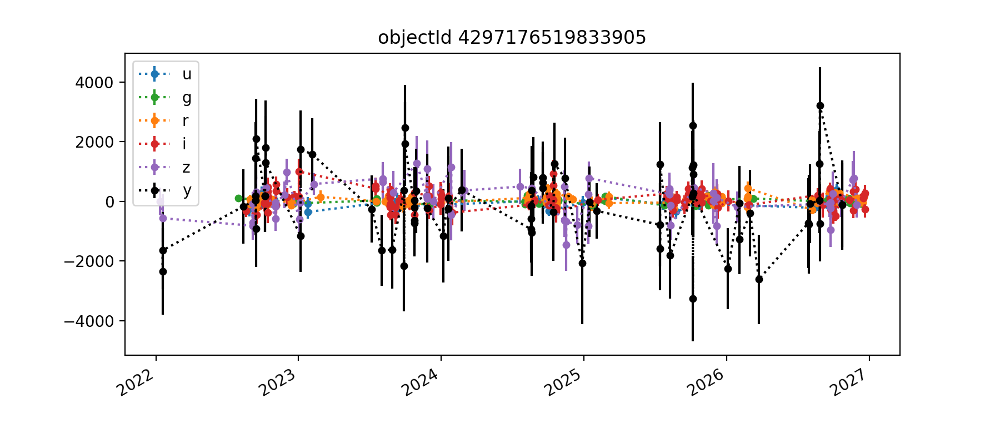

band nobs CV MAD
----------------
u 24 3.539 102.09
g 52 2.988 40.72
r 118 2.704 84.25
i 108 4.627 154.41
z 59 19.615 404.65
y 72 31.022 780.54


<IPython.core.display.Javascript object>


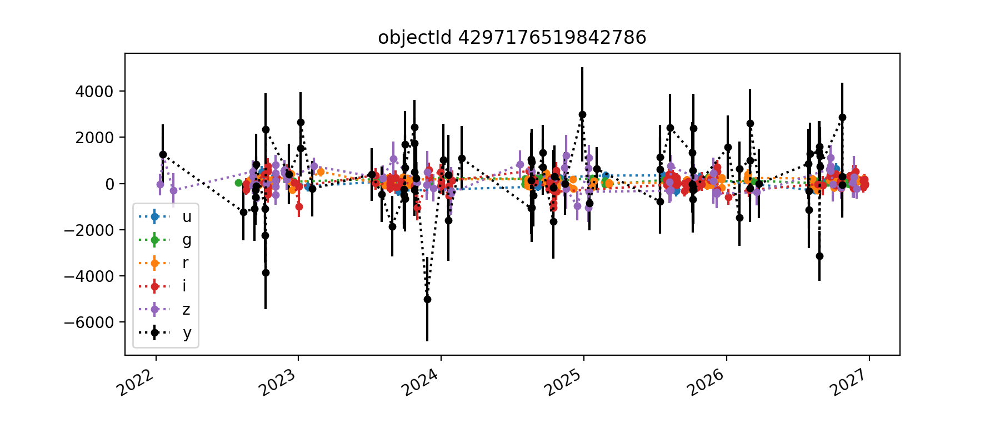

band nobs CV MAD
----------------
u 25 2.412 140.30
g 49 0.906 59.66
r 126 2.228 100.94
i 110 4.227 175.70
z 57 2.957 387.20
y 78 6.258 823.60


<IPython.core.display.Javascript object>


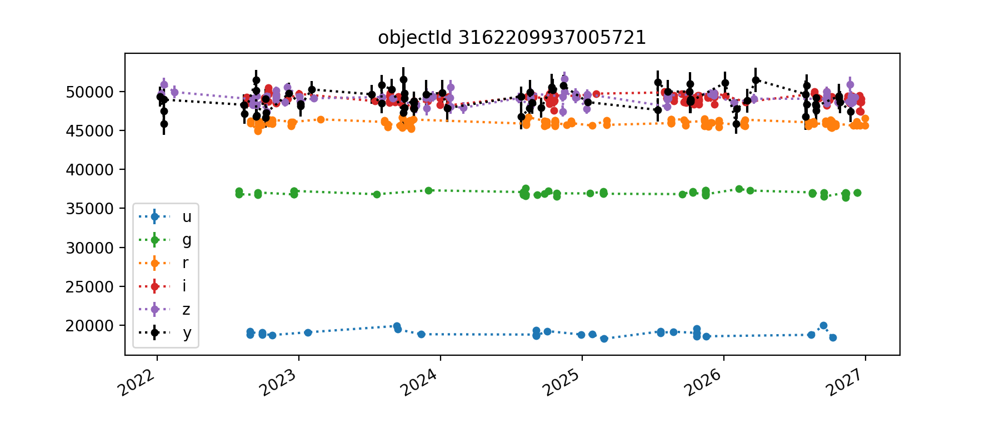

band nobs CV MAD
----------------
u 29 0.020 219.70
g 49 0.007 139.62
r 112 0.008 271.40
i 111 0.011 367.90
z 69 0.015 471.93
y 69 0.028 980.66


<IPython.core.display.Javascript object>


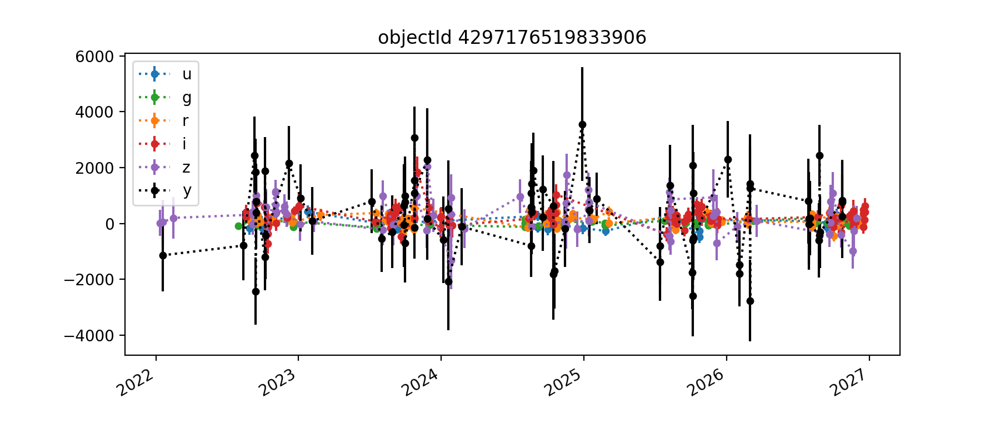

band nobs CV MAD
----------------
u 25 17.002 127.88
g 50 7.300 73.50
r 115 1.144 95.12
i 106 1.208 170.23
z 62 1.763 430.76
y 72 4.932 888.48


<IPython.core.display.Javascript object>


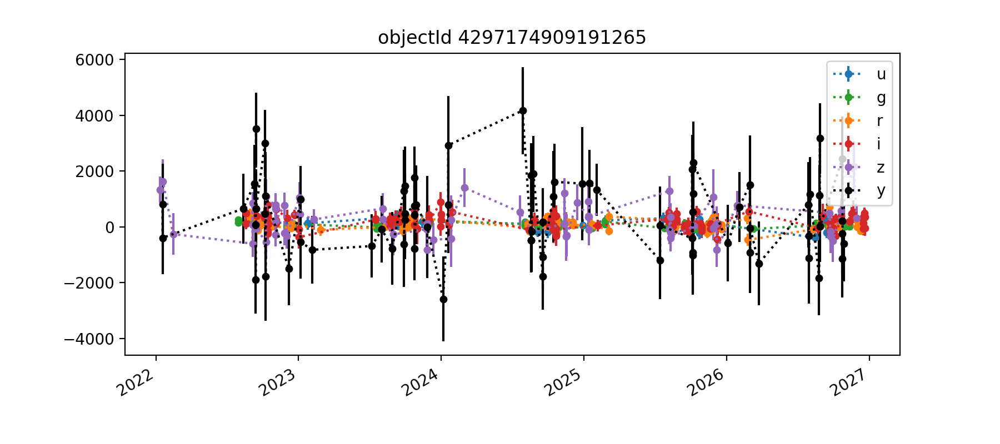

band nobs CV MAD
----------------
u 27 3.005 104.12
g 48 1.280 59.64
r 114 1.727 96.64
i 107 1.319 166.45
z 60 2.124 457.53
y 75 3.677 936.81


<IPython.core.display.Javascript object>


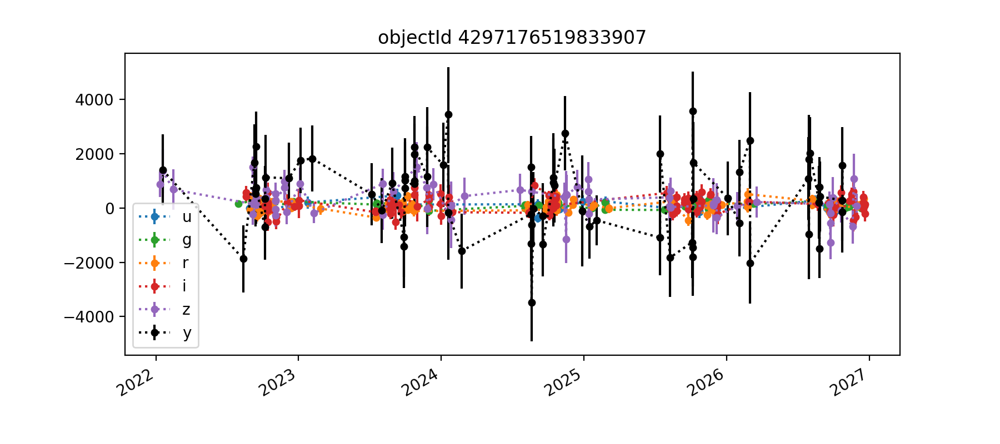

band nobs CV MAD
----------------
u 25 2.685 129.92
g 50 0.935 59.95
r 115 1.800 106.19
i 106 2.134 194.44
z 62 1.867 334.27
y 71 3.276 986.04


<IPython.core.display.Javascript object>


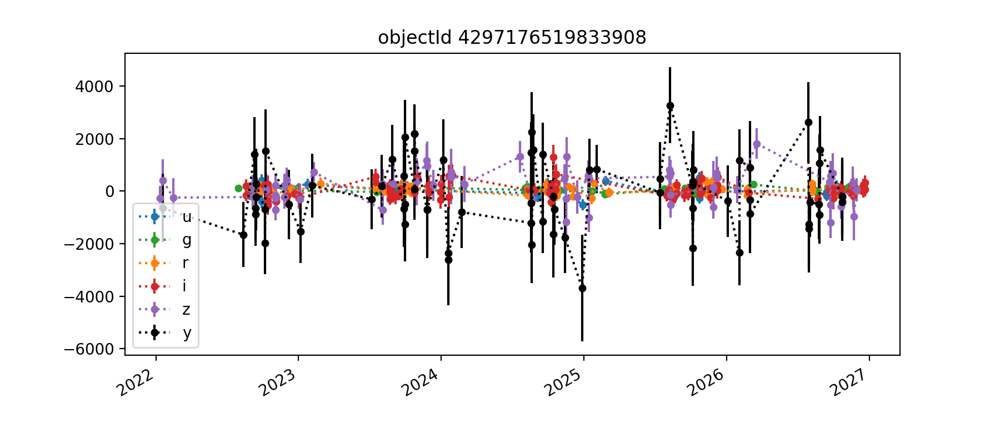

band nobs CV MAD
----------------
u 25 16.621 184.90
g 50 1.352 54.42
r 115 2.435 91.67
i 106 8.121 162.03
z 62 4.811 426.14
y 72 20.723 891.64


<IPython.core.display.Javascript object>


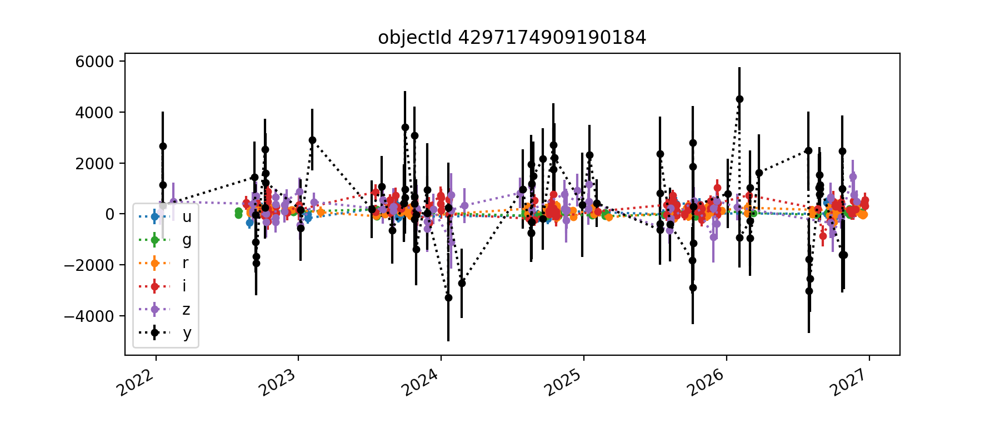

band nobs CV MAD
----------------
u 27 3.265 138.30
g 53 2.182 61.38
r 113 1.239 101.44
i 105 1.205 180.99
z 62 2.047 312.76
y 80 3.305 1062.78


<IPython.core.display.Javascript object>


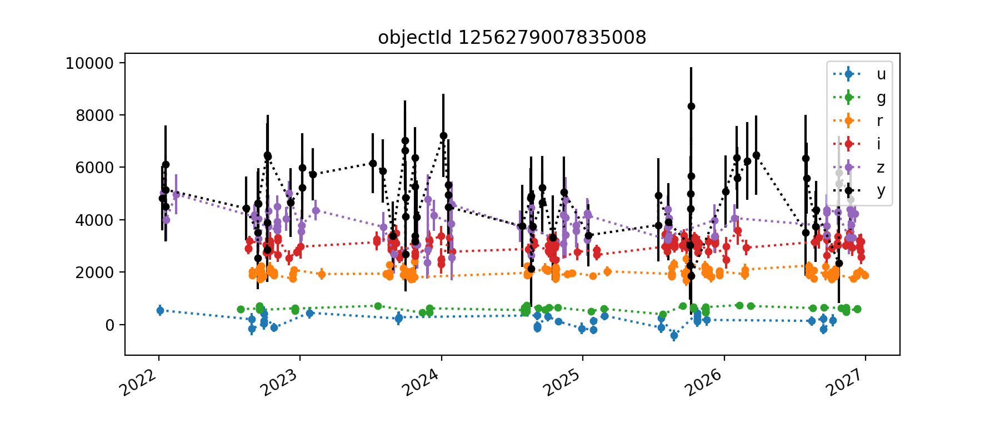

band nobs CV MAD
----------------
u 33 1.782 169.59
g 50 0.128 41.67
r 121 0.071 88.38
i 125 0.079 161.37
z 67 0.141 370.49
y 68 0.279 1002.60


<IPython.core.display.Javascript object>


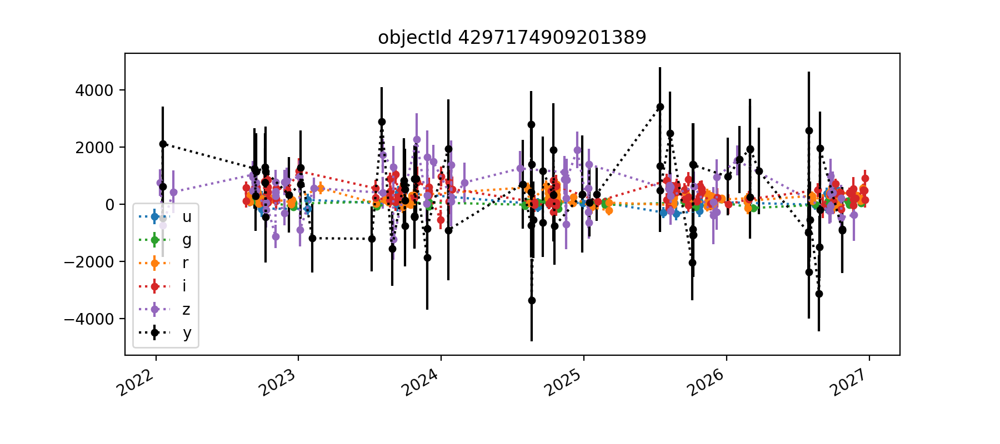

band nobs CV MAD
----------------
u 29 20.080 127.32
g 47 2.771 60.35
r 110 0.792 113.69
i 99 0.847 220.37
z 64 1.569 458.79
y 73 5.007 976.58


<IPython.core.display.Javascript object>


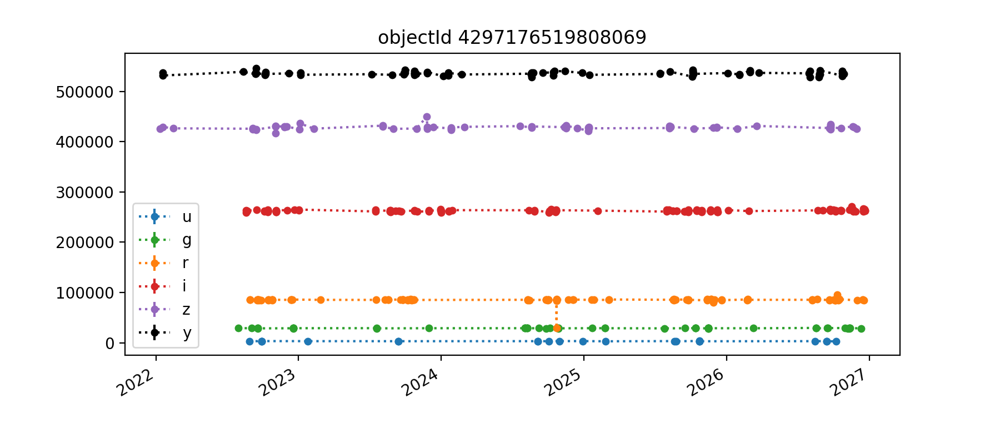

band nobs CV MAD
----------------
u 23 0.062 169.26
g 50 0.007 124.27
r 122 0.071 357.93
i 115 0.006 1161.75
z 60 0.010 1930.57
y 73 0.006 1890.65


<IPython.core.display.Javascript object>


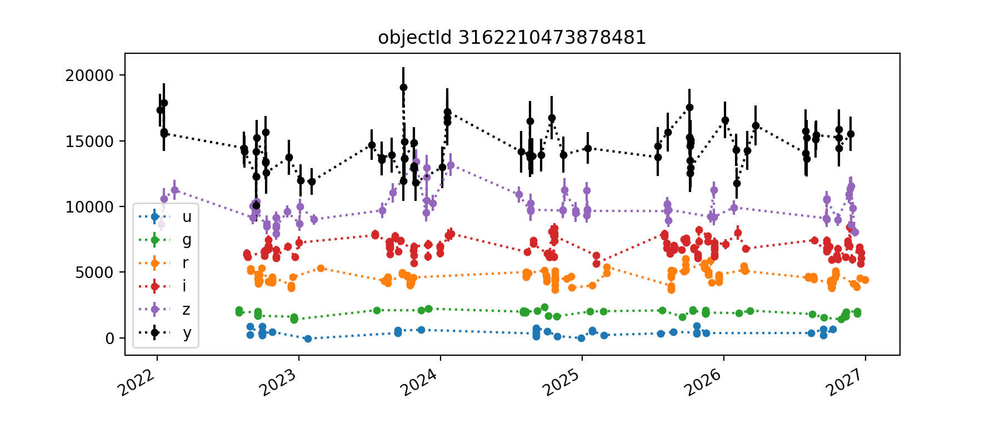

band nobs CV MAD
----------------
u 31 0.576 176.95
g 51 0.126 143.91
r 114 0.109 331.11
i 118 0.088 482.99
z 61 0.110 632.01
y 71 0.113 981.66


<IPython.core.display.Javascript object>


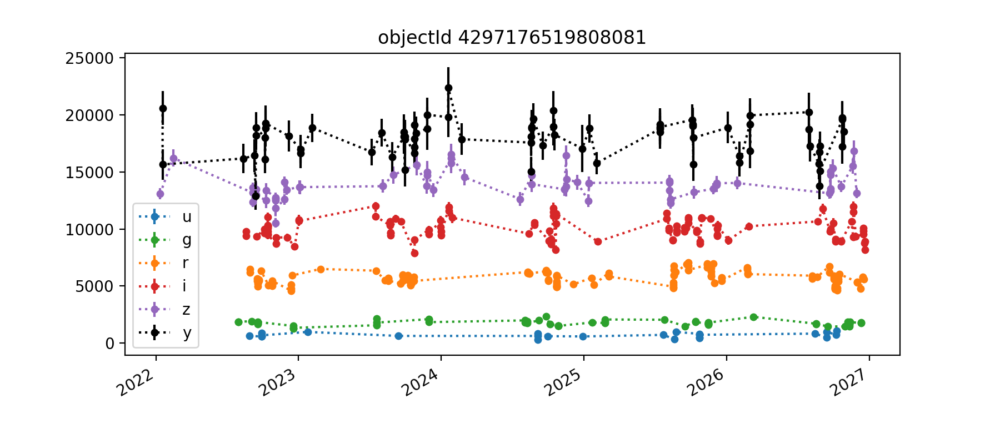

band nobs CV MAD
----------------
u 24 0.290 148.52
g 49 0.130 128.99
r 120 0.102 444.17
i 108 0.089 661.99
z 64 0.085 577.97
y 73 0.093 1012.37


<IPython.core.display.Javascript object>


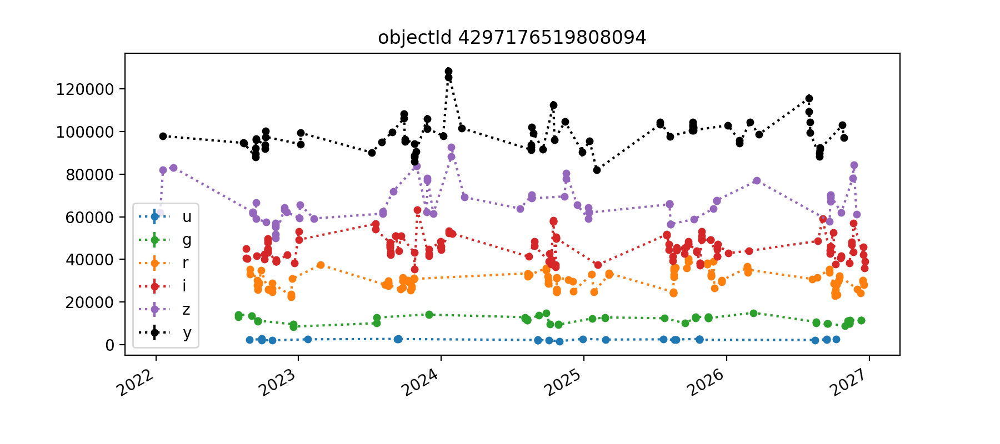

band nobs CV MAD
----------------
u 27 0.125 211.70
g 51 0.145 888.20
r 115 0.144 3450.40
i 120 0.117 3620.65
z 61 0.129 4939.41
y 69 0.079 4832.04


<IPython.core.display.Javascript object>


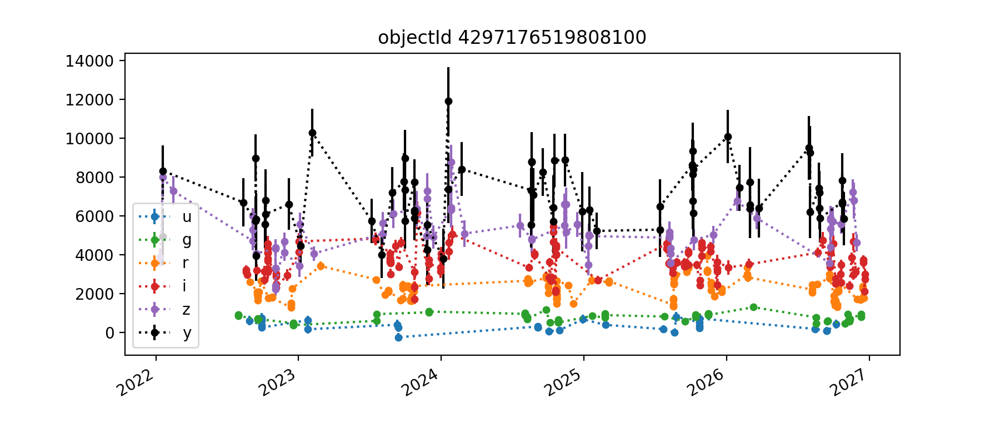

band nobs CV MAD
----------------
u 27 0.771 190.94
g 51 0.282 164.52
r 115 0.245 415.02
i 116 0.214 551.72
z 61 0.248 740.21
y 68 0.227 945.18


<IPython.core.display.Javascript object>


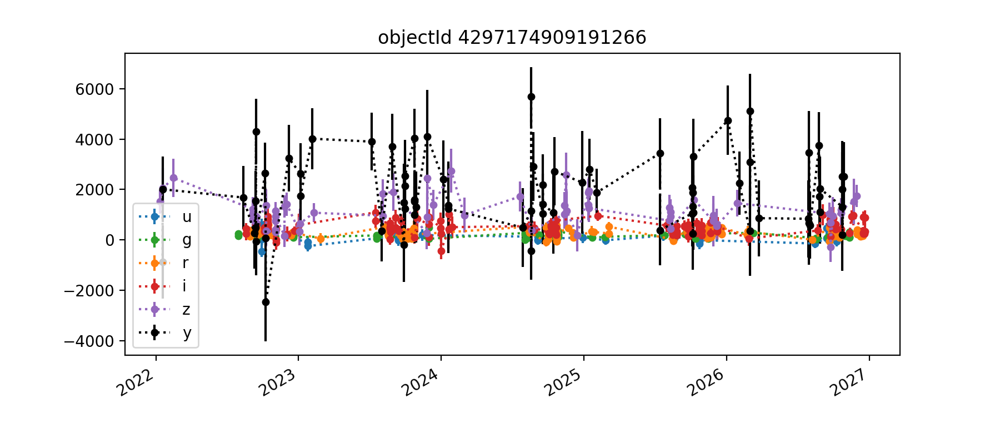

band nobs CV MAD
----------------
u 27 3.546 107.39
g 47 0.552 62.06
r 116 0.565 84.64
i 106 0.531 157.29
z 60 0.530 358.67
y 73 0.776 858.94


<IPython.core.display.Javascript object>


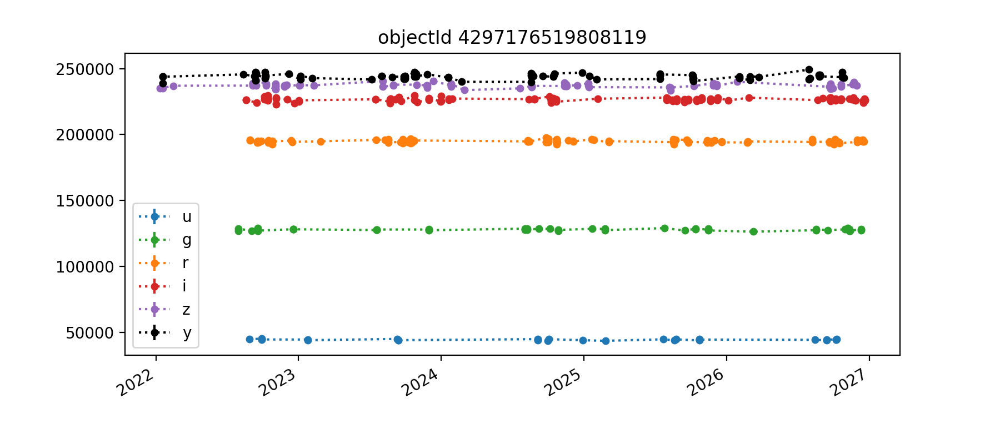

band nobs CV MAD
----------------
u 29 0.009 210.59
g 48 0.005 471.29
r 114 0.005 593.37
i 109 0.005 630.14
z 67 0.006 858.25
y 74 0.008 1211.00


<IPython.core.display.Javascript object>


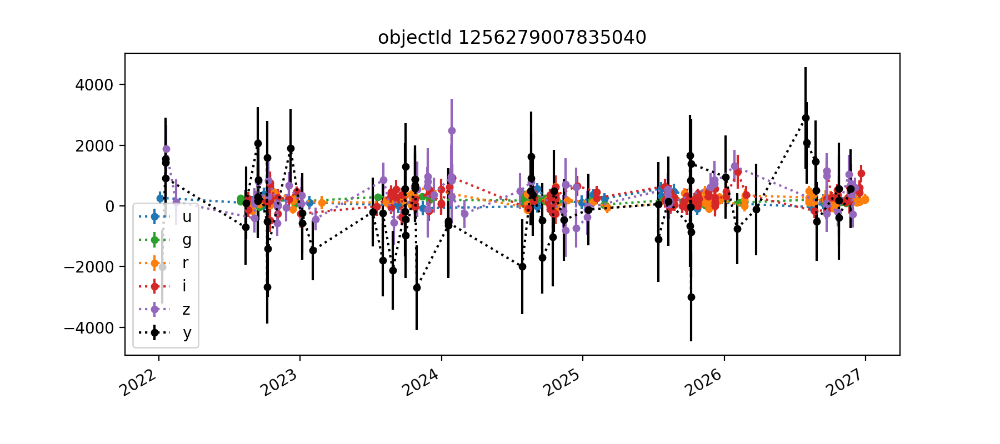

band nobs CV MAD
----------------
u 32 0.808 91.52
g 48 0.590 70.34
r 116 0.907 84.25
i 108 1.141 196.37
z 66 1.791 381.70
y 68 244.808 731.26


<IPython.core.display.Javascript object>


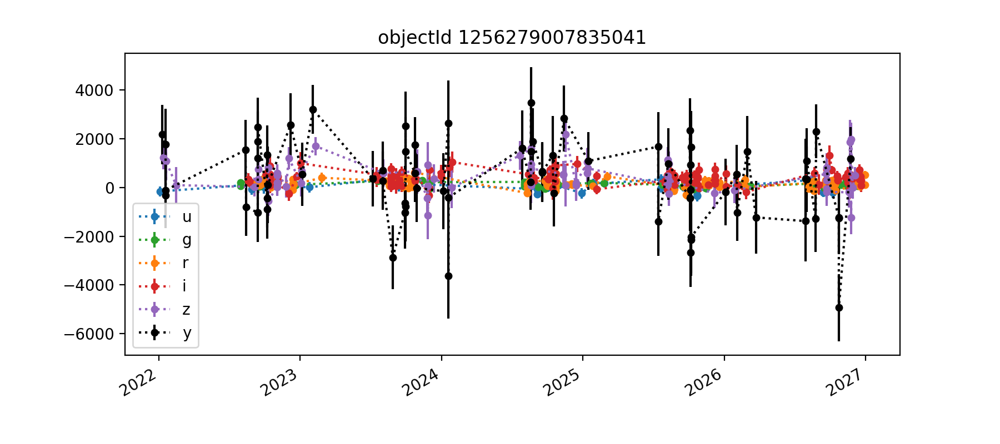

band nobs CV MAD
----------------
u 32 13.482 91.39
g 47 0.758 56.11
r 116 0.938 96.59
i 112 0.677 174.03
z 60 1.333 426.24
y 70 4.039 1126.65


In [15]:
for obj in objectList4431[0:20]:
    result4431 = analyzeObjectLc(obj, forcedSrc4431, doPlot=True, printStats=True)